In [1]:
import numpy as np
import torch
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import torch
import random

# print directory
import os
print(os.getcwd())
#os.chdir("../..")
os.chdir("../../../decoder_first")
print(os.getcwd())

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# set a random seed
seed = 0

torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

/home/dbm829/projects/interpreting_omics_models/02_experiments/notebooks
/home/dbm829/projects/decoder_first


In [2]:
### which model?
latent = 128
subset = None
seed = 0
nmix = None

experiment_name = "latent"
dataset_name = "celeb-a"
architecture_name = "imagedgd"

from src.models.DGD import DGD

hyperparams = {
    "lr": 3e-5,
    "lr_rep": 1e-2,
    "beta1": 0.7,
    "beta2": 0.7,
    "batch_size": 128,
    "weight_decay": 3e-4,
    "latent_dim": latent,
    "loss_type": "mse",
    "architecture": {
        "capacity": 16,
        "latent_dim": latent,
        "n_cells": 9,
        "loss_type": "mse",
        "image_size":64,
        "hidden_reshaper":(4, 4),
        "stride":[2,2,2,1,1,1,1,1,1],
        "kernel_size":[2,4,4,5,6,6,5,5,5],
        "padding":[0,0,0,0,0,0,0,0,0]
    }
}

model_name = (
    dataset_name
    + "_"
    + architecture_name
    + "_"
    + experiment_name
    + "_d" + str(hyperparams["latent_dim"])
    + "_rs" + str(seed)
    + "_c" + str(hyperparams["architecture"]["capacity"])
    + "_n" + str(hyperparams["architecture"]["n_cells"])
    + "_bs" + str(hyperparams["batch_size"])
)

model_name += "_test-with-cifar-hypers_1"

model = DGD(
    dataset_name,
    architecture_name,
    model_name=model_name,
    parameter_dictionary=hyperparams,
    subsample=subset,
    random_seed=seed,
    save=False
)
model.model_name = model_name
model.model_dir = '03_results/models/celeb-a/' + model_name

model.load(model.model_dir)

/home/dbm829/.conda/envs/image_dgd_env/lib/python3.11/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [3]:
# get data descriptors
data_features = model.val_set.data.attr
data_features_classes = model.train_set.classes

# get representations
reps = model.rep_val.z.detach()

# train the SAE

### utils

In [9]:
print(os.getcwd())
os.chdir("../interpreting_omics_models")
print(os.getcwd())

import torch
import torch.nn as nn
import torch.optim as optim

# Sparse Autoencoder Model with Mechanistic Interpretability
class SparseAutoencoder(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(SparseAutoencoder, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.ReLU()
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(hidden_size, input_size),
            #nn.Sigmoid()
        )
    
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded, encoded

# Mechanistic Loss Function for Sparsity and Interpretability
def loss_function(reconstructed, original, encoded, weights, sparsity_penalty, l1_weight):
    # Reconstruction loss (MSE)
    mse_loss = nn.MSELoss()(reconstructed, original)
    
    # L1 regularization for encoded activations (promotes sparsity in the hidden layer)
    l1_loss = l1_weight * torch.mean(torch.abs(encoded))

    # Weight sparsity (to promote interpretable features in the weights)
    weight_sparsity_loss = sparsity_penalty * torch.sum(torch.abs(weights))

    # Combined loss
    total_loss = mse_loss + l1_loss + weight_sparsity_loss
    return total_loss

# Function to get the unique indices of active hidden units across all samples
def get_unique_active_unit_indices(model, data_loader, threshold=1e-5):
    unique_active_indices = set()  # Use a set to store unique active neuron indices

    # Set the model to evaluation mode
    model.eval()

    with torch.no_grad():  # Disable gradient calculations for efficiency
        for data in data_loader:
            inputs = data
            
            # Forward pass through the encoder to get the hidden layer activations
            _, encoded = model(inputs)
            
            # Find the indices of the active neurons (where activation > threshold)
            active_indices_batch = (encoded > threshold).nonzero(as_tuple=False)  # Get nonzero indices

            # This returns indices in the form [batch_idx, neuron_idx]
            # We are only interested in neuron_idx for overall unique active units
            unique_active_indices.update(active_indices_batch[:, 1].tolist())

    # Convert to sorted list for convenience
    unique_active_indices = sorted(unique_active_indices)

    return unique_active_indices

# Assuming 'model' is your trained SparseAutoencoder and 'data_loader' is your dataset loader
def count_active_hidden_units(model, data_loader, threshold=1e-5):
    total_active_units = 0
    total_samples = 0

    # Set the model to evaluation mode
    model.eval()

    with torch.no_grad():  # Disable gradient calculations for efficiency
        for data in data_loader:
            inputs = data
            
            # Forward pass through the encoder to get the hidden layer activations
            _, encoded = model(inputs)
            
            # Count how many activations are above the threshold (active neurons)
            active_units_per_sample = (encoded > threshold).sum(dim=1)
            
            # Sum over all samples
            total_active_units += active_units_per_sample.sum().item()
            total_samples += inputs.size(0)

    # Calculate the average number of active units per sample
    avg_active_units = total_active_units / total_samples
    return avg_active_units

/home/dbm829/projects/interpreting_omics_models
/home/dbm829/projects/interpreting_omics_models


## test 1: 10000 hidden, l1weight 1e-3

### train

Epoch [1/500], Loss: 0.00177102
Epoch [2/500], Loss: 0.00010969
Epoch [3/500], Loss: 0.00007801
Epoch [4/500], Loss: 0.00007079
Epoch [5/500], Loss: 0.00006537
Epoch [6/500], Loss: 0.00006109
Epoch [7/500], Loss: 0.00005762
Epoch [8/500], Loss: 0.00005476
Epoch [9/500], Loss: 0.00005249
Epoch [10/500], Loss: 0.00005031
Epoch [11/500], Loss: 0.00004852
Epoch [12/500], Loss: 0.00004692
Epoch [13/500], Loss: 0.00004544
Epoch [14/500], Loss: 0.00004414
Epoch [15/500], Loss: 0.00004302
Epoch [16/500], Loss: 0.00004205
Epoch [17/500], Loss: 0.00004087
Epoch [18/500], Loss: 0.00004001
Epoch [19/500], Loss: 0.00003916
Epoch [20/500], Loss: 0.00003832
Epoch [21/500], Loss: 0.00003741
Epoch [22/500], Loss: 0.00003672
Epoch [23/500], Loss: 0.00003597
Epoch [24/500], Loss: 0.00003526
Epoch [25/500], Loss: 0.00003463
Epoch [26/500], Loss: 0.00003398
Epoch [27/500], Loss: 0.00003335
Epoch [28/500], Loss: 0.00003269
Epoch [29/500], Loss: 0.00003214
Epoch [30/500], Loss: 0.00003161
Epoch [31/500], Los

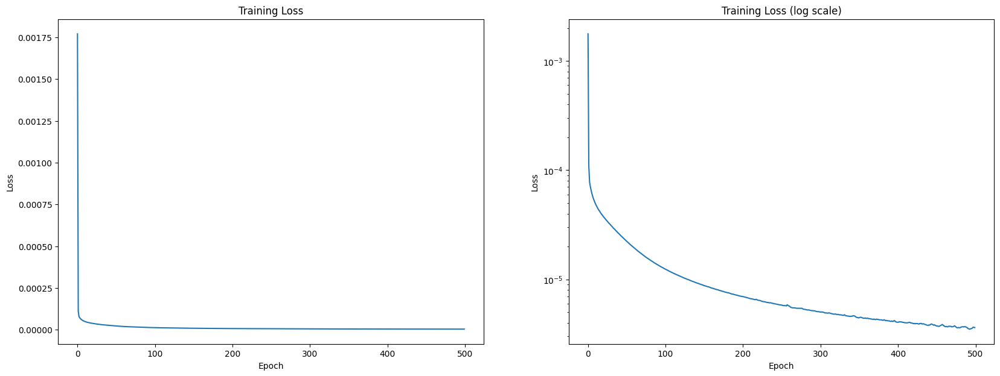

In [7]:
# Hyperparameters
input_size = latent
hidden_size = 10**4
learning_rate = 1e-4
num_epochs = 500
batch_size = 128
sparsity_penalty = 0  # Weight for weight sparsity
l1_weight = 1e-3  # Weight for activation sparsity
#early_stopping = 10

# Load dataset (Replace with your own dataset)
# Example using random data, replace with actual dataset
train_data = reps.clone().to(device)
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, shuffle=True)

# Initialize model
sae_model = SparseAutoencoder(input_size, hidden_size)
sae_model = sae_model.to(device)

# Optimizer
optimizer = optim.Adam(sae_model.parameters(), lr=learning_rate)

# Training loop
losses = []
for epoch in range(num_epochs):

    # early stopping if the last 10 epochs have not improved the loss
    #if len(losses) > early_stopping:
    #    if np.min(losses[-early_stopping:]) == losses[-early_stopping]:
    #        print(f'Early stopping at epoch {epoch + 1}')
    #        break
    
    total_loss = 0
    for x in train_loader:
        # Get inputs and convert to torch Variable
        inputs = x
        inputs = inputs.to(device)
        
        # Forward pass
        outputs, encoded = sae_model(inputs)
        
        # Compute loss
        loss = loss_function(
            outputs, 
            inputs, 
            encoded, 
            sae_model.encoder[0].weight,  # Pass the encoder's weights for weight sparsity
            sparsity_penalty, 
            l1_weight
        )
        
        # Backprop and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
    
    losses.append(total_loss / len(train_loader))
    
    print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {total_loss / len(train_loader):.8f}')

print("Training complete.")

# plot loss curve (normal) and log_scaled
import matplotlib.pyplot as plt
fig, axs = plt.subplots(1, 2, figsize=(20, 7))
axs[0].plot(losses)
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Loss')
axs[0].set_title('Training Loss')
axs[1].plot(losses)
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Loss')
axs[1].set_title('Training Loss (log scale)')
axs[1].set_yscale('log')
plt.show()

### finding SAE features that correspond to binary data classes

In [8]:
reps_reconstructed, activations = sae_model(reps.to(device))

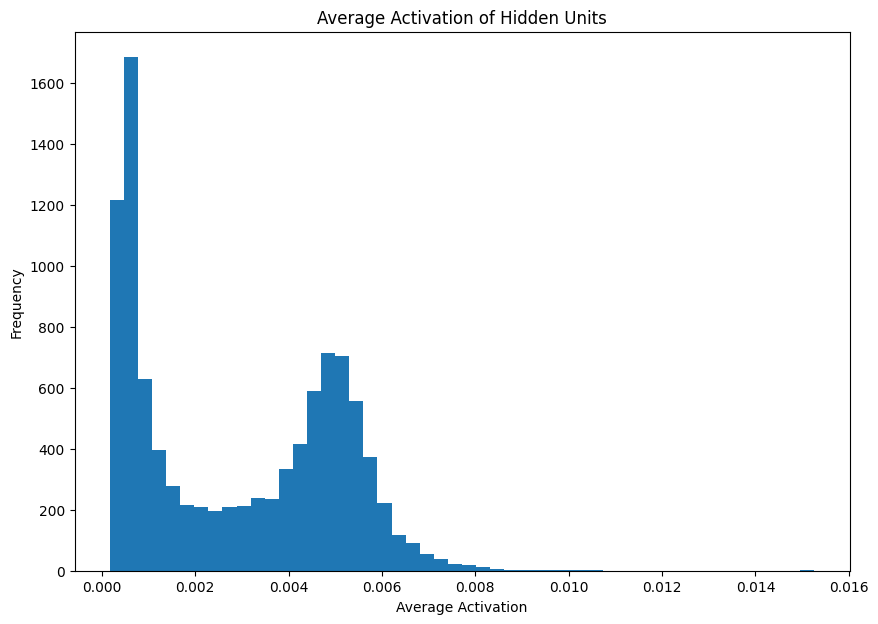

In [26]:
# plot the average activations of the hidden units
avg_activations = activations.mean(dim=0).cpu().detach().numpy()
plt.figure(figsize=(10, 7))
plt.hist(avg_activations, bins=50)
plt.xlabel('Average Activation')
plt.ylabel('Frequency')
plt.title('Average Activation of Hidden Units')
plt.show()

In [11]:
n_activation_features = activations.shape[1]
print(f'Number of activation features: {n_activation_features}')

# check which activation features are active at all
threshold = 1e-10

unique_active_unit_indices = get_unique_active_unit_indices(sae_model, train_loader, threshold=threshold)
print(f'Unique Active Neuron Indices: {unique_active_unit_indices}')
print(f'Number of unique active hidden units: {len(unique_active_unit_indices)}')

avg_active_hidden_units = count_active_hidden_units(sae_model, train_loader, threshold=threshold)
print(f'Average number of active hidden units per sample: {avg_active_hidden_units:.2f}')

Number of activation features: 10000
Unique Active Neuron Indices: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 20

In [25]:
from scipy import stats
from statsmodels.stats.multitest import multipletests

# for all categorical features of the data, get p values and adjusted p values between the feature and the activation

p_values = np.zeros((len(unique_active_unit_indices), data_features.shape[1]))
adjusted_p_values = np.zeros((len(unique_active_unit_indices), data_features.shape[1]))
fold_changes = np.zeros((len(unique_active_unit_indices), data_features.shape[1]))

for i, feat in enumerate(unique_active_unit_indices):
    # get the activations
    feat_activation = activations[:, feat]
    for j in range(data_features.shape[1]):
        categorical_feature = data_features[:, j]
        activ_pos = feat_activation[categorical_feature == 1].clone().detach().cpu().numpy()
        activ_neg = feat_activation[categorical_feature == 0].clone().detach().cpu().numpy()
        # get the p value from unpaired t test
        t_stat, p_val = stats.ttest_ind(activ_pos, activ_neg, equal_var=False)
        p_values[i, j] = p_val
        adjusted_p_values[i, j] = multipletests([p_val], method='fdr_bh')[1][0]
        fold_changes[i, j] = np.mean(activ_pos) / np.mean(activ_neg)

KeyboardInterrupt: 

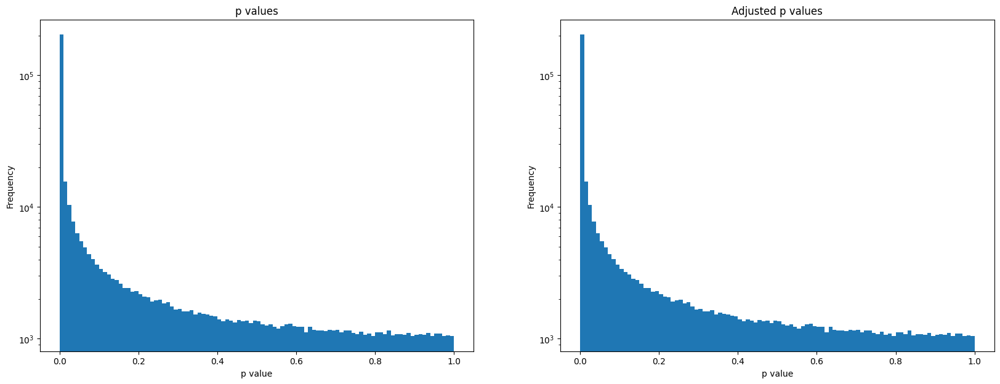

In [24]:
# plot the p values and adjusted p values as histograms

fig, axs = plt.subplots(1, 2, figsize=(20, 7))
axs[0].hist(p_values.flatten(), bins=100)
axs[0].set_xlabel('p value')
axs[0].set_ylabel('Frequency')
axs[0].set_title('p values')
axs[0].set_yscale('log')
axs[1].hist(adjusted_p_values.flatten(), bins=100)
axs[1].set_xlabel('p value')
axs[1].set_ylabel('Frequency')
axs[1].set_title('Adjusted p values')
axs[1].set_yscale('log')
plt.show()

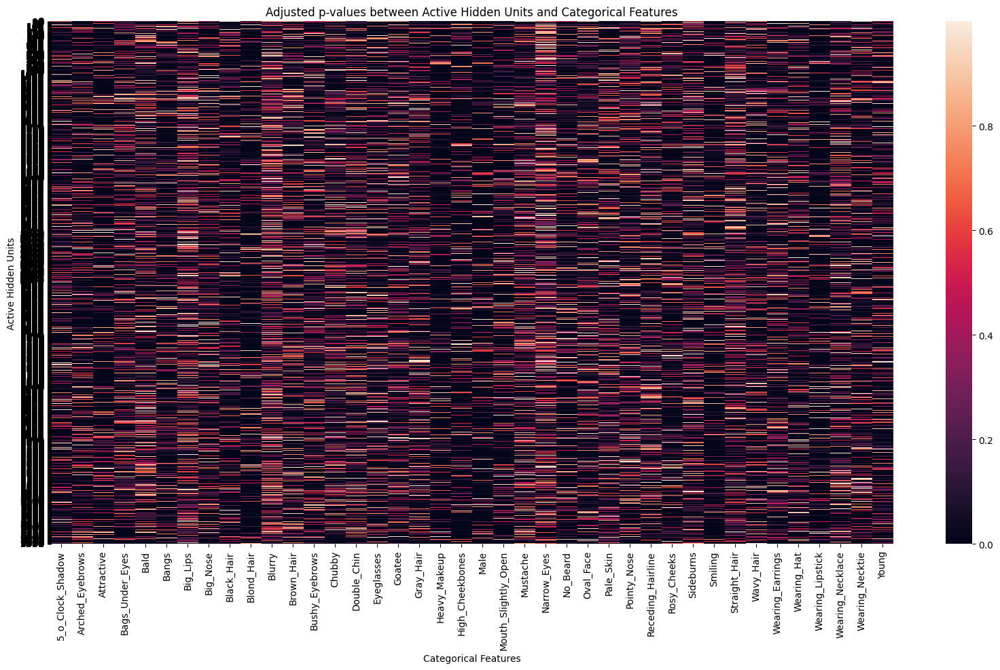

In [15]:
# plot a heatmap of the adjusted p values

plt.figure(figsize=(20, 10))
sns.heatmap(adjusted_p_values, xticklabels=data_features_classes, yticklabels=unique_active_unit_indices)
plt.xlabel('Categorical Features')
plt.ylabel('Active Hidden Units')
plt.title('Adjusted p-values between Active Hidden Units and Categorical Features')
plt.show()

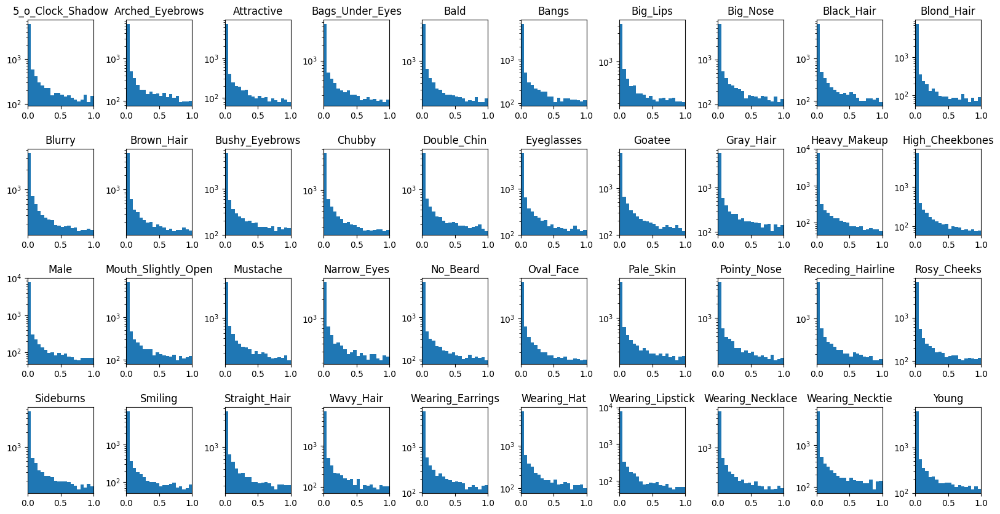

In [22]:
# plot a histogram for the correlations of each column

import math
n_rows = 4
n_cols = math.ceil(adjusted_p_values.shape[1] / n_rows)


fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, 10))
# add spacing
plt.subplots_adjust(hspace=0.5, wspace=0.5)
for i in range(adjusted_p_values.shape[1]):
    axs[i // n_cols, i % n_cols].hist(adjusted_p_values[:, i], bins=20)
    axs[i // n_cols, i % n_cols].set_title(data_features_classes[i])
    # x limits should be -1, 1
    axs[i // n_cols, i % n_cols].set_xlim(0, 1)
    # log scale
    axs[i // n_cols, i % n_cols].set_yscale('log')
plt.show()

In [ ]:
# plot a histogram for the correlations of each column

import math
n_rows = 4
n_cols = math.ceil(adjusted_p_values.shape[1] / n_rows)


fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, 10))
# add spacing
plt.subplots_adjust(hspace=0.5, wspace=0.5)
for i in range(adjusted_p_values.shape[1]):
    # plot the adjusted p values against fold change
    axs[i // n_cols, i % n_cols].scatter(fold_changes[:, i], adjusted_p_values[:, i])
    axs[i // n_cols, i % n_cols].set_title(data_features_classes[i])
plt.show()

In [ ]:
# for each column, show the highest correlating activation feature

adjusted_p_values = pd.DataFrame(adjusted_p_values, columns=data_features_classes, index=unique_active_unit_indices)

best_ids = []
best_pvals = []

for i in range(adjusted_p_values.shape[1]):
    #non_zero = adjusted_p_values[:, i] > 0
    #best_id = adjusted_p_values[non_zero, i].idxmin()
    best_id = adjusted_p_values[:, i].idxmin()
    best_ids.append(best_id)
    #best_pvals.append(adjusted_p_values[non_zero, i].max())
    best_pvals.append(adjusted_p_values[:, i].min())

# make a dataframe
df_best = pd.DataFrame({'Data feature': adjusted_p_values.columns, 'SAE feature': best_ids, 'Correlation': best_pvals}, index=data_features_classes)
print(df_best)

## test 2: l1weight 1e-2 and 1000 epochs

Epoch [1/1000], Loss: 0.00203232
Epoch [2/1000], Loss: 0.00038085
Epoch [3/1000], Loss: 0.00033656
Epoch [4/1000], Loss: 0.00031416
Epoch [5/1000], Loss: 0.00029274
Epoch [6/1000], Loss: 0.00027215
Epoch [7/1000], Loss: 0.00025241
Epoch [8/1000], Loss: 0.00023384
Epoch [9/1000], Loss: 0.00021667
Epoch [10/1000], Loss: 0.00020097
Epoch [11/1000], Loss: 0.00018690
Epoch [12/1000], Loss: 0.00017444
Epoch [13/1000], Loss: 0.00016342
Epoch [14/1000], Loss: 0.00015382
Epoch [15/1000], Loss: 0.00014558
Epoch [16/1000], Loss: 0.00013831
Epoch [17/1000], Loss: 0.00013195
Epoch [18/1000], Loss: 0.00012633
Epoch [19/1000], Loss: 0.00012132
Epoch [20/1000], Loss: 0.00011685
Epoch [21/1000], Loss: 0.00011276
Epoch [22/1000], Loss: 0.00010906
Epoch [23/1000], Loss: 0.00010557
Epoch [24/1000], Loss: 0.00010236
Epoch [25/1000], Loss: 0.00009937
Epoch [26/1000], Loss: 0.00009662
Epoch [27/1000], Loss: 0.00009393
Epoch [28/1000], Loss: 0.00009143
Epoch [29/1000], Loss: 0.00008909
Epoch [30/1000], Loss: 

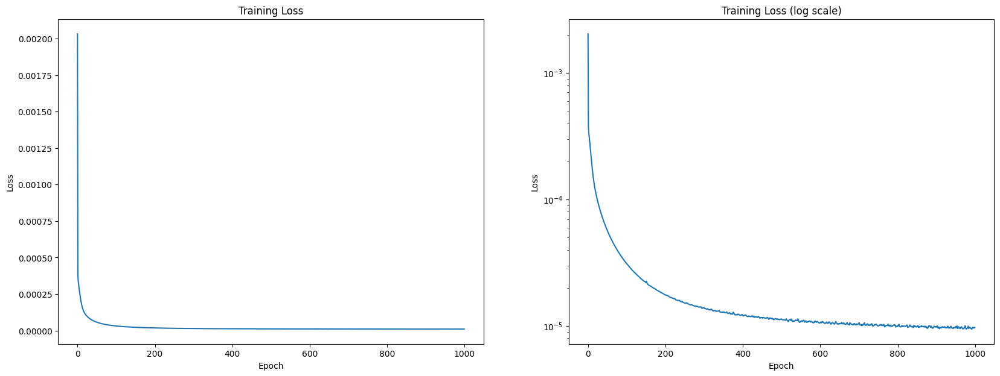

In [37]:
# Hyperparameters
input_size = latent
hidden_size = 10**4
learning_rate = 1e-4
num_epochs = 1000
batch_size = 128
sparsity_penalty = 0  # Weight for weight sparsity
l1_weight = 1e-2  # Weight for activation sparsity
#early_stopping = 10

# Load dataset (Replace with your own dataset)
# Example using random data, replace with actual dataset
train_data = reps.clone().to(device)
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, shuffle=True)

# Initialize model
sae_model = SparseAutoencoder(input_size, hidden_size)
sae_model = sae_model.to(device)

# Optimizer
optimizer = optim.Adam(sae_model.parameters(), lr=learning_rate)

# Training loop
losses = []
for epoch in range(num_epochs):

    # early stopping if the last 10 epochs have not improved the loss
    #if len(losses) > early_stopping:
    #    if np.min(losses[-early_stopping:]) == losses[-early_stopping]:
    #        print(f'Early stopping at epoch {epoch + 1}')
    #        break
    
    total_loss = 0
    for x in train_loader:
        # Get inputs and convert to torch Variable
        inputs = x
        inputs = inputs.to(device)
        
        # Forward pass
        outputs, encoded = sae_model(inputs)
        
        # Compute loss
        loss = loss_function(
            outputs, 
            inputs, 
            encoded, 
            sae_model.encoder[0].weight,  # Pass the encoder's weights for weight sparsity
            sparsity_penalty, 
            l1_weight
        )
        
        # Backprop and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
    
    losses.append(total_loss / len(train_loader))
    
    print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {total_loss / len(train_loader):.8f}')

print("Training complete.")

# plot loss curve (normal) and log_scaled
import matplotlib.pyplot as plt
fig, axs = plt.subplots(1, 2, figsize=(20, 7))
axs[0].plot(losses)
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Loss')
axs[0].set_title('Training Loss')
axs[1].plot(losses)
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Loss')
axs[1].set_title('Training Loss (log scale)')
axs[1].set_yscale('log')
plt.show()

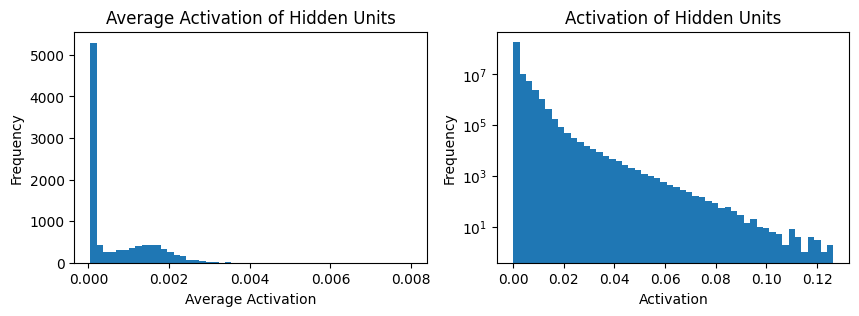

In [38]:
# plot the average activations of the hidden units

reps_reconstructed, activations = sae_model(reps.to(device))

avg_activations = activations.mean(dim=0).cpu().detach().numpy()
fig, ax = plt.subplots(1, 2, figsize=(10, 3))
ax[0].hist(avg_activations, bins=50)
ax[0].set_xlabel('Average Activation')
ax[0].set_ylabel('Frequency')
ax[0].set_title('Average Activation of Hidden Units')
ax[1].hist(activations.detach().cpu().numpy().flatten(), bins=50)
ax[1].set_xlabel('Activation')
ax[1].set_ylabel('Frequency')
ax[1].set_title('Activation of Hidden Units')
ax[1].set_yscale('log')
plt.show()

In [41]:
n_activation_features = activations.shape[1]
print(f'Number of activation features: {n_activation_features}')

# check which activation features are active at all
threshold = 0.0001

unique_active_unit_indices = get_unique_active_unit_indices(sae_model, train_loader, threshold=threshold)
print(f'Unique Active Neuron Indices: {unique_active_unit_indices}')
print(f'Number of unique active hidden units: {len(unique_active_unit_indices)}')

avg_active_hidden_units = count_active_hidden_units(sae_model, train_loader, threshold=threshold)
print(f'Average number of active hidden units per sample: {avg_active_hidden_units:.2f}')

Number of activation features: 10000
Unique Active Neuron Indices: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 20

In [42]:
# this does not seem to work well here, so I am going to take hidden features as unique with a threshold of the mean

unique_active_unit_indices = np.where(avg_activations > threshold)[0]
print(f'Number of unique active hidden units: {len(unique_active_unit_indices)}')

Number of unique active hidden units: 7605


In [43]:
from scipy import stats
from statsmodels.stats.multitest import multipletests

# for all categorical features of the data, get p values and adjusted p values between the feature and the activation

p_values = np.zeros((len(unique_active_unit_indices), data_features.shape[1]))
adjusted_p_values = np.zeros((len(unique_active_unit_indices), data_features.shape[1]))
fold_changes = np.zeros((len(unique_active_unit_indices), data_features.shape[1]))

for i, feat in enumerate(unique_active_unit_indices):
    # get the activations
    feat_activation = activations[:, feat]
    for j in range(data_features.shape[1]):
        categorical_feature = data_features[:, j]
        activ_pos = feat_activation[categorical_feature == 1].clone().detach().cpu().numpy()
        activ_neg = feat_activation[categorical_feature == 0].clone().detach().cpu().numpy()
        # get the p value from unpaired t test
        t_stat, p_val = stats.ttest_ind(activ_pos, activ_neg, equal_var=False)
        p_values[i, j] = p_val
        adjusted_p_values[i, j] = multipletests([p_val], method='fdr_bh')[1][0]
        fold_changes[i, j] = np.mean(activ_pos) / np.mean(activ_neg)

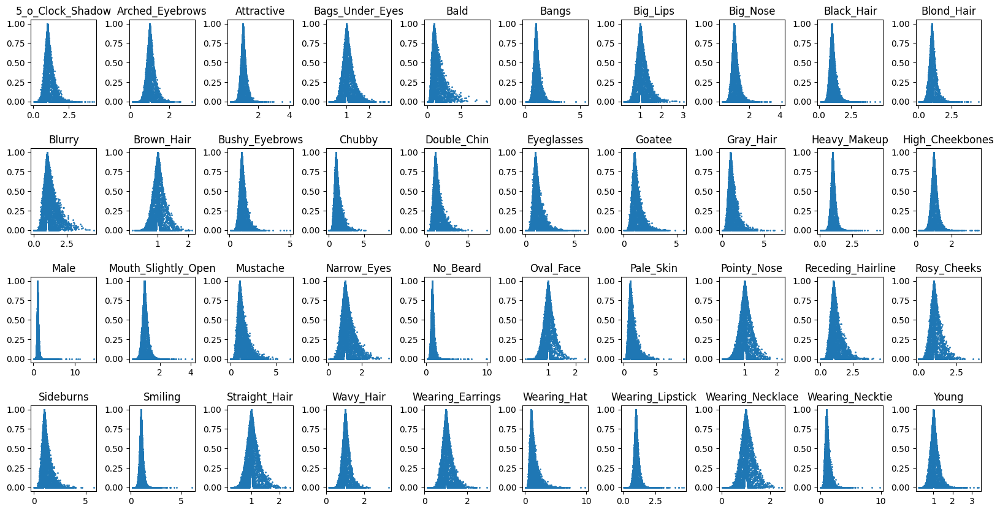

In [46]:
# plot a histogram for the correlations of each column

import math
n_rows = 4
n_cols = math.ceil(adjusted_p_values.shape[1] / n_rows)


fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, 10))
# add spacing
plt.subplots_adjust(hspace=0.5, wspace=0.5)
for i in range(adjusted_p_values.shape[1]):
    # plot the adjusted p values against fold change
    axs[i // n_cols, i % n_cols].scatter(fold_changes[:, i], adjusted_p_values[:, i], s=1)
    axs[i // n_cols, i % n_cols].set_title(data_features_classes[i])
plt.show()

In [51]:
# for every feature, get the best correlating activation feature
# in order to do so, we sort by fold changes and kick out all that are not significant (p value below threshold)

p_val_trheshold = 0.05
fold_change_threshold = 2.0

df_relevant_features = pd.DataFrame(columns=['fold_change', 'p_value', 'feature', 'sae_feature'])

for i in range(adjusted_p_values.shape[1]):
    df_temp = pd.DataFrame({'fold_change': fold_changes[:, i], 'p_value': adjusted_p_values[:, i]}, index=unique_active_unit_indices)
    df_temp = df_temp[df_temp['p_value'] < p_val_trheshold]
    df_temp = df_temp.sort_values('fold_change', ascending=False)
    df_temp = df_temp[df_temp['fold_change'] > fold_change_threshold]
    # reduce it to the top 5
    df_temp = df_temp.head(5)
    df_temp['feature'] = data_features_classes[i]
    df_temp['sae_feature'] = df_temp.index
    df_relevant_features = pd.concat([df_relevant_features, df_temp])

print(df_relevant_features)

      fold_change       p_value           feature sae_feature
7109     4.215809  7.647689e-10  5_o_Clock_Shadow        7109
2399     4.119639  4.238852e-11  5_o_Clock_Shadow        2399
691      3.921082  3.218767e-05  5_o_Clock_Shadow         691
6035     3.805950  1.516868e-04  5_o_Clock_Shadow        6035
6329     3.629557  4.566190e-06  5_o_Clock_Shadow        6329
...           ...           ...               ...         ...
4131     3.336704  1.962151e-07             Young        4131
8586     3.270235  5.121356e-07             Young        8586
2194     3.085326  5.222517e-06             Young        2194
1643     2.906396  9.597228e-05             Young        1643
8143     2.746612  1.468759e-06             Young        8143

[190 rows x 4 columns]


/tmp/ipykernel_408198/2114858905.py:18: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_relevant_features = pd.concat([df_relevant_features, df_temp])


In [55]:
# for every feature, get the best correlating activation feature
# in order to do so, we sort by fold changes and kick out all that are not significant (p value below threshold)

p_val_trheshold = 0.05
fold_change_threshold = 0.5

df_anticorr_features = pd.DataFrame(columns=['fold_change', 'p_value', 'feature', 'sae_feature'])

for i in range(adjusted_p_values.shape[1]):
    df_temp = pd.DataFrame({'fold_change': fold_changes[:, i], 'p_value': adjusted_p_values[:, i]}, index=unique_active_unit_indices)
    df_temp = df_temp[df_temp['p_value'] < p_val_trheshold]
    df_temp = df_temp.sort_values('fold_change', ascending=True)
    df_temp = df_temp[df_temp['fold_change'] < fold_change_threshold]
    # reduce it to the top 5
    df_temp = df_temp.head(5)
    df_temp['feature'] = data_features_classes[i]
    df_temp['sae_feature'] = df_temp.index
    df_anticorr_features = pd.concat([df_anticorr_features, df_temp])

print(df_anticorr_features)

      fold_change       p_value           feature sae_feature
2853     0.052928  7.528267e-19  5_o_Clock_Shadow        2853
2761     0.072187  4.018375e-29  5_o_Clock_Shadow        2761
3634     0.083003  7.018084e-17  5_o_Clock_Shadow        3634
7324     0.088795  6.930580e-78  5_o_Clock_Shadow        7324
2375     0.091572  2.424971e-39  5_o_Clock_Shadow        2375
...           ...           ...               ...         ...
1254     0.233839  4.986529e-09             Young        1254
1404     0.254927  3.141209e-07             Young        1404
3795     0.257848  2.031399e-06             Young        3795
8864     0.272213  3.232654e-06             Young        8864
7696     0.283982  2.546844e-06             Young        7696

[200 rows x 4 columns]


/tmp/ipykernel_408198/2548009976.py:18: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_anticorr_features = pd.concat([df_anticorr_features, df_temp])


### investigate a specific feature: hair color alone is too unspecific (this even the latent space can figure out)

In [52]:
data_features_classes

['5_o_Clock_Shadow',
 'Arched_Eyebrows',
 'Attractive',
 'Bags_Under_Eyes',
 'Bald',
 'Bangs',
 'Big_Lips',
 'Big_Nose',
 'Black_Hair',
 'Blond_Hair',
 'Blurry',
 'Brown_Hair',
 'Bushy_Eyebrows',
 'Chubby',
 'Double_Chin',
 'Eyeglasses',
 'Goatee',
 'Gray_Hair',
 'Heavy_Makeup',
 'High_Cheekbones',
 'Male',
 'Mouth_Slightly_Open',
 'Mustache',
 'Narrow_Eyes',
 'No_Beard',
 'Oval_Face',
 'Pale_Skin',
 'Pointy_Nose',
 'Receding_Hairline',
 'Rosy_Cheeks',
 'Sideburns',
 'Smiling',
 'Straight_Hair',
 'Wavy_Hair',
 'Wearing_Earrings',
 'Wearing_Hat',
 'Wearing_Lipstick',
 'Wearing_Necklace',
 'Wearing_Necktie',
 'Young']

In [56]:
print("positive correlation with black hair")
print(df_relevant_features[df_relevant_features['feature'] == 'Black_Hair'])
print("negative correlation with black hair")
print(df_anticorr_features[df_anticorr_features['feature'] == 'Black_Hair'])

print("positive correlation with blond hair")
print(df_relevant_features[df_relevant_features['feature'] == 'Blond_Hair'])
print("negative correlation with blond hair")
print(df_anticorr_features[df_anticorr_features['feature'] == 'Blond_Hair'])

positive correlation with black hair
      fold_change       p_value     feature sae_feature
8514     4.751189  1.108803e-12  Black_Hair        8514
2851     4.338499  8.965334e-08  Black_Hair        2851
2926     3.997032  6.560248e-06  Black_Hair        2926
1268     3.724913  1.450569e-05  Black_Hair        1268
6074     3.608395  1.083457e-05  Black_Hair        6074
negative correlation with black hair
      fold_change       p_value     feature sae_feature
1559     0.120847  9.132141e-14  Black_Hair        1559
4677     0.145691  2.941747e-10  Black_Hair        4677
6746     0.158425  2.464148e-13  Black_Hair        6746
4428     0.178056  4.115924e-15  Black_Hair        4428
2109     0.182020  9.291803e-25  Black_Hair        2109
positive correlation with blond hair
      fold_change       p_value     feature sae_feature
1276     4.572257  1.102513e-08  Blond_Hair        1276
2011     3.978485  2.394801e-12  Blond_Hair        2011
6339     3.798099  2.680749e-08  Blond_Hair      

In [61]:
black_hair_index = data_features_classes.index('Black_Hair')
blonde_hair_index = data_features_classes.index('Blond_Hair')

p_vals_black_hair = adjusted_p_values[:, black_hair_index]
p_vals_blonde_hair = adjusted_p_values[:, blonde_hair_index]

fold_changes_black_hair = fold_changes[:, black_hair_index]
fold_changes_blonde_hair = fold_changes[:, blonde_hair_index]

df_haircolor = pd.DataFrame({
    'sae_feature': unique_active_unit_indices,
    'p_value_black_hair': p_vals_black_hair,
    'fold_change_black_hair': fold_changes_black_hair,
    'p_value_blonde_hair': p_vals_blonde_hair,
    'fold_change_blonde_hair': fold_changes_blonde_hair
})
print(len(df_haircolor))

# limit to the relevant features

p_val_trheshold = 0.05
fold_change_thresholds = [0.5, 2]

df_haircolor = df_haircolor[(df_haircolor['p_value_black_hair'] < p_val_trheshold) & (df_haircolor['p_value_blonde_hair'] < p_val_trheshold)]
print(len(df_haircolor))
df_haircolor_black_hair = df_haircolor[(df_haircolor['fold_change_black_hair'] > fold_change_thresholds[1]) & (df_haircolor['fold_change_blonde_hair'] < fold_change_thresholds[0])]
df_haircolor_blonde_hair = df_haircolor[(df_haircolor['fold_change_black_hair'] < fold_change_thresholds[0]) & (df_haircolor['fold_change_blonde_hair'] > fold_change_thresholds[1])]
df_haircolor = pd.concat([df_haircolor_black_hair, df_haircolor_blonde_hair])
print(len(df_haircolor))
print(df_haircolor)

7605
3761
264
      sae_feature  p_value_black_hair  fold_change_black_hair  \
2               2        5.277885e-12                2.010633   
24             28        4.760642e-15                2.144736   
61             79        1.230816e-02                2.076713   
78            101        9.414507e-04                2.242761   
109           146        2.989202e-03                2.086769   
...           ...                 ...                     ...   
6697         8822        2.641728e-04                0.424460   
7253         9533        1.290023e-05                0.368626   
7343         9653        5.949351e-04                0.477053   
7478         9831        1.250156e-04                0.358277   
7516         9887        1.010928e-03                0.391026   

      p_value_blonde_hair  fold_change_blonde_hair  
2            2.358182e-54                 0.172992  
24           1.885902e-45                 0.218204  
61           3.388963e-07                 0.17

In [77]:
black_hair_index = data_features_classes.index('Black_Hair')
blonde_hair_index = data_features_classes.index('Blond_Hair')

p_vals_black_hair = adjusted_p_values[:, black_hair_index]
p_vals_blonde_hair = adjusted_p_values[:, blonde_hair_index]

fold_changes_black_hair = fold_changes[:, black_hair_index]
fold_changes_blonde_hair = fold_changes[:, blonde_hair_index]

df_haircolor = pd.DataFrame({
    'sae_feature': unique_active_unit_indices,
    'p_value_black_hair': p_vals_black_hair,
    'fold_change_black_hair': fold_changes_black_hair,
    'p_value_blonde_hair': p_vals_blonde_hair,
    'fold_change_blonde_hair': fold_changes_blonde_hair
})
print(len(df_haircolor))

# limit to the relevant features

p_val_trheshold = 1e-3
fold_change_thresholds = [0.5, 2]

df_haircolor = df_haircolor[(df_haircolor['p_value_black_hair'] < p_val_trheshold) & (df_haircolor['p_value_blonde_hair'] < p_val_trheshold)]

df_haircolor_black_hair = df_haircolor[(df_haircolor['fold_change_black_hair'] > fold_change_thresholds[1]) & (df_haircolor['fold_change_blonde_hair'] < fold_change_thresholds[0])]
# compute ranks of the fold changes (higher fold change is better)
df_haircolor_black_hair['rank_black_hair'] = df_haircolor_black_hair['fold_change_black_hair'].rank(ascending=False)
df_haircolor_black_hair['rank_blonde_hair'] = df_haircolor_black_hair['fold_change_blonde_hair'].rank(ascending=True)
# sort by rank of black hair
df_haircolor_black_hair = df_haircolor_black_hair.sort_values('rank_black_hair')
df_haircolor_black_hair['combined_rank'] = df_haircolor_black_hair['rank_black_hair'] + df_haircolor_black_hair['rank_blonde_hair']
# sort by combined rank
df_haircolor_black_hair = df_haircolor_black_hair.sort_values('combined_rank')

df_haircolor_blonde_hair = df_haircolor[(df_haircolor['fold_change_black_hair'] < fold_change_thresholds[0]) & (df_haircolor['fold_change_blonde_hair'] > fold_change_thresholds[1])]
# compute ranks of the fold changes (higher fold change is better)
df_haircolor_blonde_hair['rank_black_hair'] = df_haircolor_blonde_hair['fold_change_black_hair'].rank(ascending=True)
df_haircolor_blonde_hair['rank_blonde_hair'] = df_haircolor_blonde_hair['fold_change_blonde_hair'].rank(ascending=False)
# sort by rank of blonde hair
df_haircolor_blonde_hair = df_haircolor_blonde_hair.sort_values('rank_blonde_hair')
df_haircolor_blonde_hair['combined_rank'] = df_haircolor_blonde_hair['rank_black_hair'] + df_haircolor_blonde_hair['rank_blonde_hair']
# sort by combined rank
df_haircolor_blonde_hair = df_haircolor_blonde_hair.sort_values('combined_rank', ascending=False)

#df_haircolor = pd.concat([df_haircolor_black_hair, df_haircolor_blonde_hair])
#print(df_haircolor)

7605


/tmp/ipykernel_408198/3989361943.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_haircolor_black_hair['rank_black_hair'] = df_haircolor_black_hair['fold_change_black_hair'].rank(ascending=False)
/tmp/ipykernel_408198/3989361943.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_haircolor_black_hair['rank_blonde_hair'] = df_haircolor_black_hair['fold_change_blonde_hair'].rank(ascending=True)
/tmp/ipykernel_408198/3989361943.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of

In [87]:
df_haircolor_black_hair.head(10)

,sae_feature,p_value_black_hair,fold_change_black_hair,p_value_blonde_hair,fold_change_blonde_hair,rank_black_hair,rank_blonde_hair,combined_rank
1828,2449,9.757409e-07,3.525699,5.943701e-24,0.007800,7.0,2.0,9.0
7243,9521,1.274930e-09,3.189547,2.139848e-35,0.039706,14.0,6.0,20.0
222,280,3.188688e-07,3.586559,5.021271e-16,0.070335,6.0,18.0,24.0
6463,8514,1.108803e-12,4.751189,2.971024e-22,0.102441,1.0,33.0,34.0
3114,4131,6.054485e-05,3.061309,8.587489e-16,0.079396,16.0,23.0,39.0
2926,3878,7.987119e-05,2.753413,2.144204e-19,0.028934,38.0,3.0,41.0
1790,2399,4.911401e-09,2.825247,1.880773e-35,0.056939,31.0,12.0,43.0
2184,2926,6.560248e-06,3.997032,5.527691e-11,0.126317,3.0,42.0,45.0
412,526,5.062387e-05,2.996490,1.098497e-16,0.087523,20.0,28.0,48.0
4917,6487,3.733330e-05,2.706259,9.924906e-22,0.038807,43.0,5.0,48.0


In [88]:
df_haircolor_blonde_hair.head(10)

,sae_feature,p_value_black_hair,fold_change_black_hair,p_value_blonde_hair,fold_change_blonde_hair,rank_black_hair,rank_blonde_hair,combined_rank
4296,5658,6.557355e-03,0.497417,1.204642e-02,2.017279,2.0,2.0,4.0
73,92,2.602037e-56,0.496611,2.918264e-50,2.097944,3.0,8.0,11.0
1797,2407,4.851773e-87,0.456274,5.610639e-63,2.004402,11.0,1.0,12.0
7343,9653,5.949351e-04,0.477053,5.305413e-03,2.126397,6.0,11.0,17.0
3325,4435,1.347219e-03,0.457358,4.930097e-03,2.131611,10.0,12.0,22.0
6697,8822,2.641728e-04,0.424460,5.176492e-03,2.075631,16.0,7.0,23.0
4063,5373,1.085889e-91,0.488083,1.130648e-96,2.293237,4.0,21.0,25.0
2711,3609,1.795013e-04,0.423065,6.257134e-03,2.189117,17.0,15.0,32.0
6633,8734,1.648293e-07,0.429075,6.248523e-06,2.222444,14.0,18.0,32.0
368,457,1.182342e-03,0.463764,1.443879e-03,2.328070,7.0,25.0,32.0


In [86]:
black_hair_index = data_features_classes.index('Black_Hair')
blonde_hair_index = data_features_classes.index('Blond_Hair')

p_vals_black_hair = adjusted_p_values[:, black_hair_index]
p_vals_blonde_hair = adjusted_p_values[:, blonde_hair_index]

fold_changes_black_hair = fold_changes[:, black_hair_index]
fold_changes_blonde_hair = fold_changes[:, blonde_hair_index]

df_haircolor = pd.DataFrame({
    'sae_feature': unique_active_unit_indices,
    'p_value_black_hair': p_vals_black_hair,
    'fold_change_black_hair': fold_changes_black_hair,
    'p_value_blonde_hair': p_vals_blonde_hair,
    'fold_change_blonde_hair': fold_changes_blonde_hair
})
print(len(df_haircolor))

# limit to the relevant features

p_val_trheshold = 0.05
fold_change_thresholds = [0.5, 2]

df_haircolor = df_haircolor[(df_haircolor['p_value_black_hair'] < p_val_trheshold) & (df_haircolor['p_value_blonde_hair'] < p_val_trheshold)]

df_haircolor_black_hair = df_haircolor[(df_haircolor['fold_change_black_hair'] > fold_change_thresholds[1]) & (df_haircolor['fold_change_blonde_hair'] < fold_change_thresholds[0])]
# compute ranks of the fold changes (higher fold change is better)
df_haircolor_black_hair['rank_black_hair'] = df_haircolor_black_hair['fold_change_black_hair'].rank(ascending=False)
df_haircolor_black_hair['rank_blonde_hair'] = df_haircolor_black_hair['fold_change_blonde_hair'].rank(ascending=True)
# sort by rank of black hair
df_haircolor_black_hair = df_haircolor_black_hair.sort_values('rank_black_hair')
df_haircolor_black_hair['combined_rank'] = df_haircolor_black_hair['rank_black_hair'] + df_haircolor_black_hair['rank_blonde_hair']
# sort by rank
df_haircolor_black_hair = df_haircolor_black_hair.sort_values('combined_rank')

df_haircolor_blonde_hair = df_haircolor[(df_haircolor['fold_change_black_hair'] < fold_change_thresholds[0]) & (df_haircolor['fold_change_blonde_hair'] > fold_change_thresholds[1])]
# compute ranks of the fold changes (higher fold change is better)
# do it the "wrong way" around so the ranks between black and blonde hair are comparable
df_haircolor_blonde_hair['rank_black_hair'] = df_haircolor_blonde_hair['fold_change_black_hair'].rank(ascending=False)
df_haircolor_blonde_hair['rank_blonde_hair'] = df_haircolor_blonde_hair['fold_change_blonde_hair'].rank(ascending=True)
# sort by rank of blonde hair
df_haircolor_blonde_hair = df_haircolor_blonde_hair.sort_values('rank_blonde_hair')
df_haircolor_blonde_hair['combined_rank'] = df_haircolor_blonde_hair['rank_black_hair'] + df_haircolor_blonde_hair['rank_blonde_hair']
# sort by combined rank
df_haircolor_blonde_hair = df_haircolor_blonde_hair.sort_values('combined_rank')

# get the sae_features from both and show the intersect
sae_features_black_hair = set(df_haircolor_black_hair['sae_feature'])
sae_features_blonde_hair = set(df_haircolor_blonde_hair['sae_feature'])

print(sae_features_black_hair.intersection(sae_features_blonde_hair))

7605
set()


/tmp/ipykernel_408198/1165750763.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_haircolor_black_hair['rank_black_hair'] = df_haircolor_black_hair['fold_change_black_hair'].rank(ascending=False)
/tmp/ipykernel_408198/1165750763.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_haircolor_black_hair['rank_blonde_hair'] = df_haircolor_black_hair['fold_change_blonde_hair'].rank(ascending=True)
/tmp/ipykernel_408198/1165750763.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of

In [90]:
black_hair_index = data_features_classes.index('Black_Hair')
blonde_hair_index = data_features_classes.index('Blond_Hair')

p_vals_black_hair = adjusted_p_values[:, black_hair_index]
p_vals_blonde_hair = adjusted_p_values[:, blonde_hair_index]

fold_changes_black_hair = fold_changes[:, black_hair_index]
fold_changes_blonde_hair = fold_changes[:, blonde_hair_index]

df_haircolor = pd.DataFrame({
    'sae_feature': unique_active_unit_indices,
    'p_value_black_hair': p_vals_black_hair,
    'fold_change_black_hair': fold_changes_black_hair,
    'p_value_blonde_hair': p_vals_blonde_hair,
    'fold_change_blonde_hair': fold_changes_blonde_hair
})
print(len(df_haircolor))

# limit to the relevant features

p_val_trheshold = 0.05
fold_change_thresholds = [0.5, 2]

df_haircolor = df_haircolor[(df_haircolor['p_value_black_hair'] < p_val_trheshold) & (df_haircolor['p_value_blonde_hair'] < p_val_trheshold)]

df_haircolor['rank_black_hair'] = df_haircolor['fold_change_black_hair'].rank(ascending=False)
df_haircolor['rank_blonde_hair'] = df_haircolor['fold_change_blonde_hair'].rank(ascending=True)
# sort by rank of black hair
df_haircolor = df_haircolor.sort_values('rank_black_hair')
df_haircolor['combined_rank'] = df_haircolor['rank_black_hair'] + df_haircolor['rank_blonde_hair']
# sort by rank
df_haircolor = df_haircolor.sort_values('combined_rank')

df_haircolor.head(10)

7605


,sae_feature,p_value_black_hair,fold_change_black_hair,p_value_blonde_hair,fold_change_blonde_hair,rank_black_hair,rank_blonde_hair,combined_rank
1828,2449,9.757409e-07,3.525699,5.943701e-24,0.007800,7.0,2.0,9.0
7243,9521,1.274930e-09,3.189547,2.139848e-35,0.039706,14.0,9.0,23.0
222,280,3.188688e-07,3.586559,5.021271e-16,0.070335,6.0,25.0,31.0
2926,3878,7.987119e-05,2.753413,2.144204e-19,0.028934,38.0,6.0,44.0
6463,8514,1.108803e-12,4.751189,2.971024e-22,0.102441,1.0,45.0,46.0
3114,4131,6.054485e-05,3.061309,8.587489e-16,0.079396,16.0,30.0,46.0
1790,2399,4.911401e-09,2.825247,1.880773e-35,0.056939,31.0,17.0,48.0
4917,6487,3.733330e-05,2.706259,9.924906e-22,0.038807,43.0,8.0,51.0
412,526,5.062387e-05,2.996490,1.098497e-16,0.087523,20.0,37.0,57.0
3890,5153,1.476318e-04,3.248166,1.322661e-12,0.117131,11.0,54.0,65.0


In [91]:
# make a pca of the representations

from sklearn.decomposition import PCA

pca = PCA(n_components=2)
reps_pca = pca.fit_transform(reps.detach().cpu().numpy())

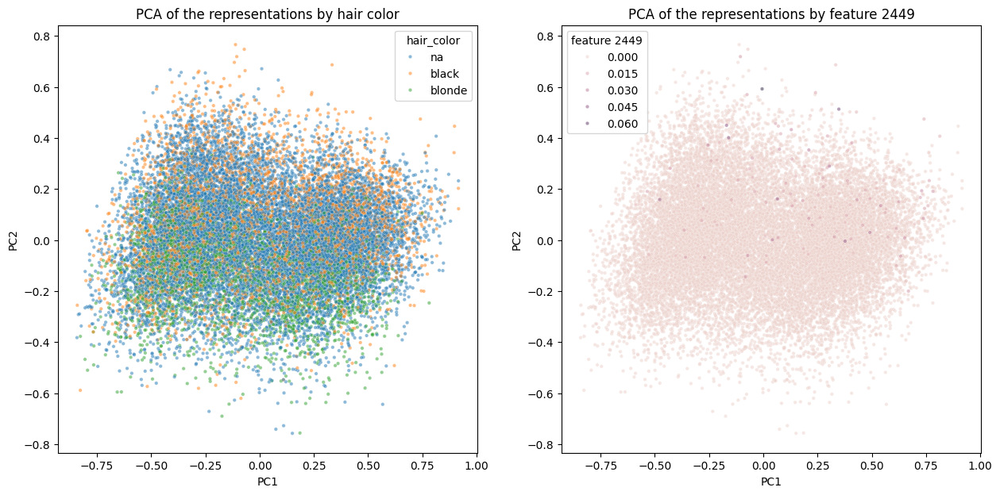

In [98]:
feat = 2449

df_pca = pd.DataFrame(reps_pca, columns=['PC1', 'PC2'])
df_pca['hair_color'] = 'na'
df_pca['hair_color'] = ['black' if x == 1 else df_pca['hair_color'].values[i] for i, x in enumerate(data_features[:, black_hair_index].numpy())]
df_pca['hair_color'] = ['blonde' if x == 1 else df_pca['hair_color'].values[i] for i, x in enumerate(data_features[:, blonde_hair_index].numpy())]
df_pca[f'feature {feat}'] = activations[:, feat].detach().cpu().numpy()

fig, ax = plt.subplots(1, 2, figsize=(15,7))
sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='hair_color', ax=ax[0], s=10, alpha=0.5)
ax[0].set_title('PCA of the representations by hair color')
sns.scatterplot(data=df_pca.sort_values(f'feature {feat}'), x='PC1', y='PC2', hue=f'feature {feat}', ax=ax[1], s=10, alpha=0.5)
ax[1].set_title(f'PCA of the representations by feature {feat}')
plt.show()

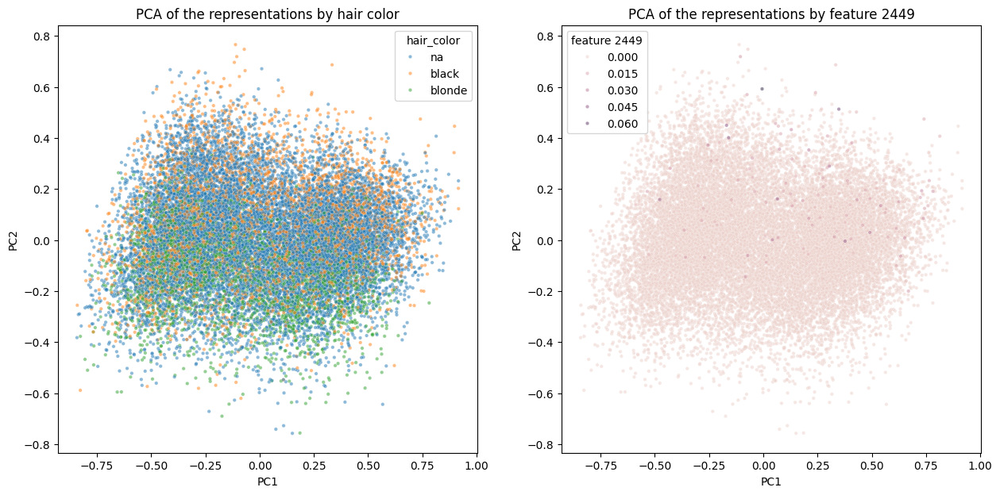

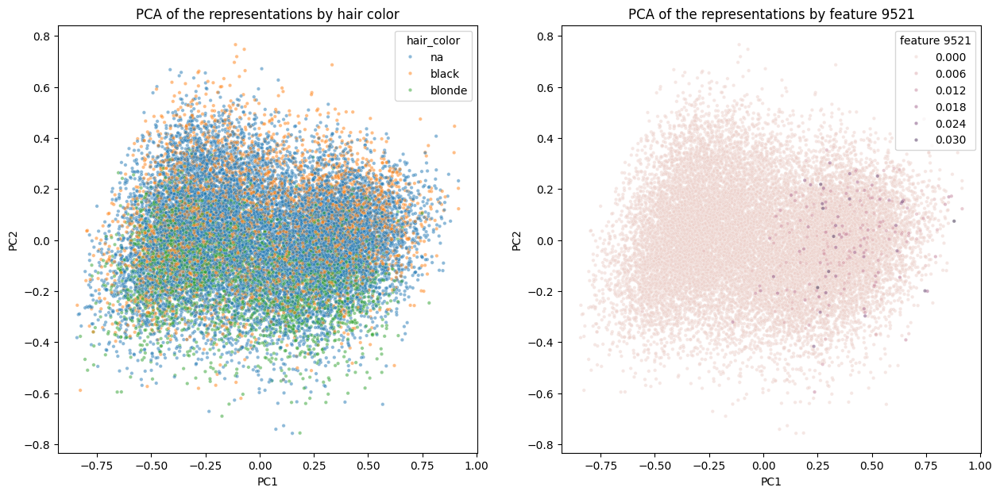

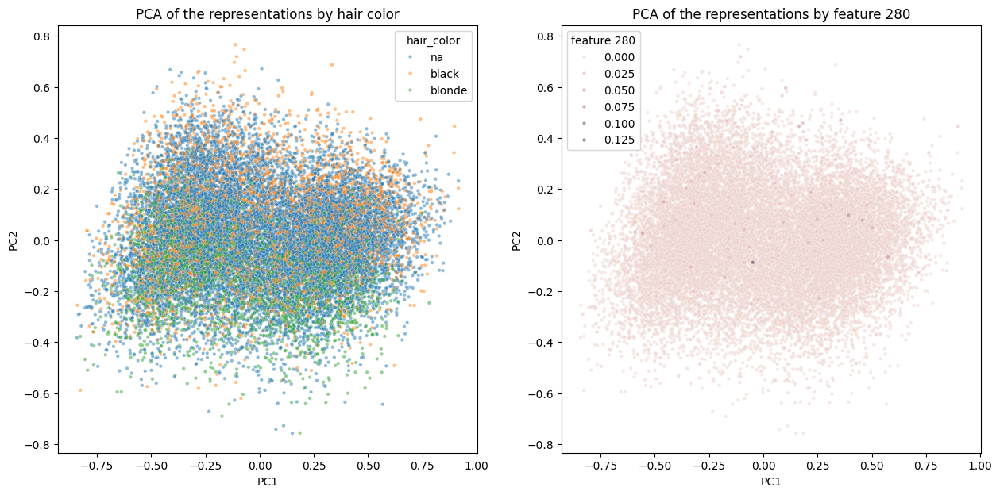

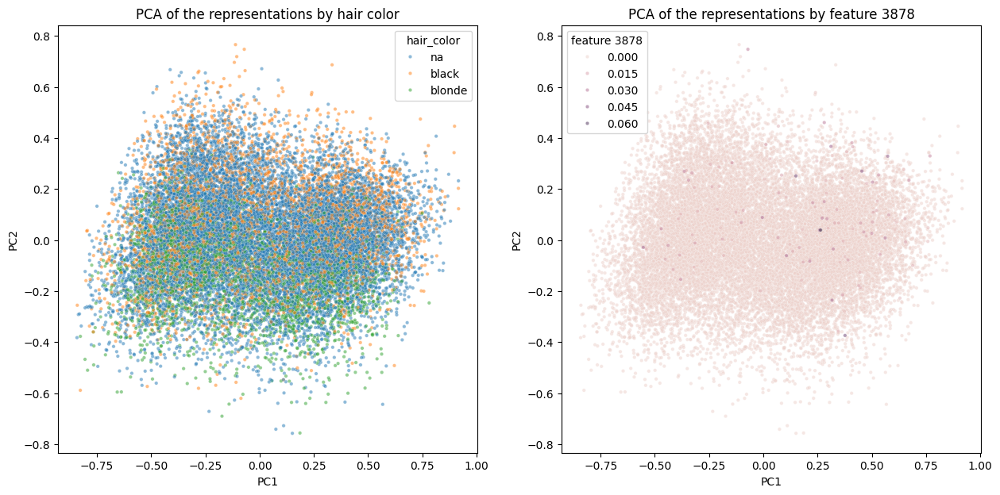

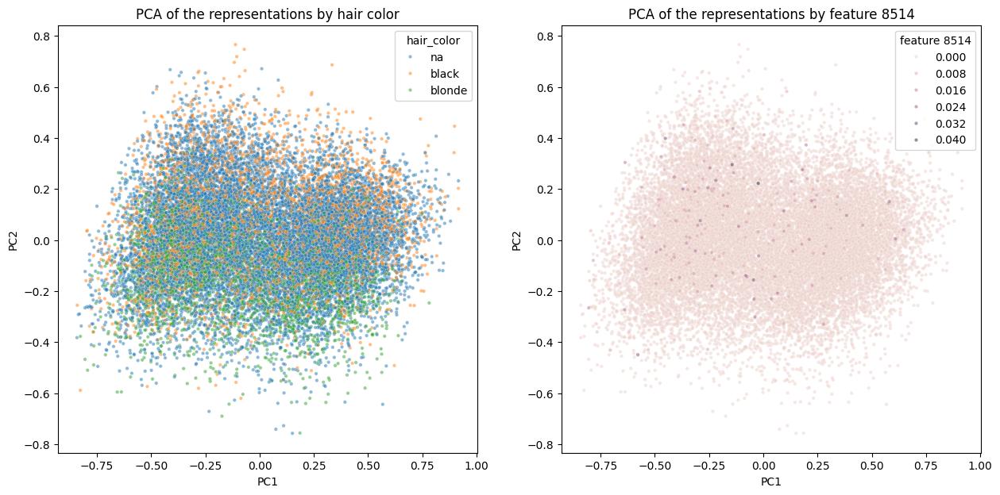

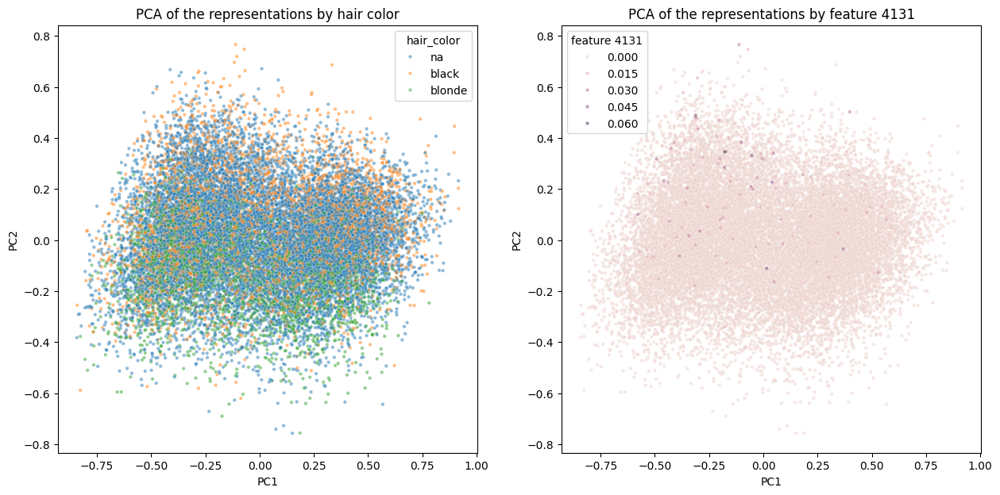

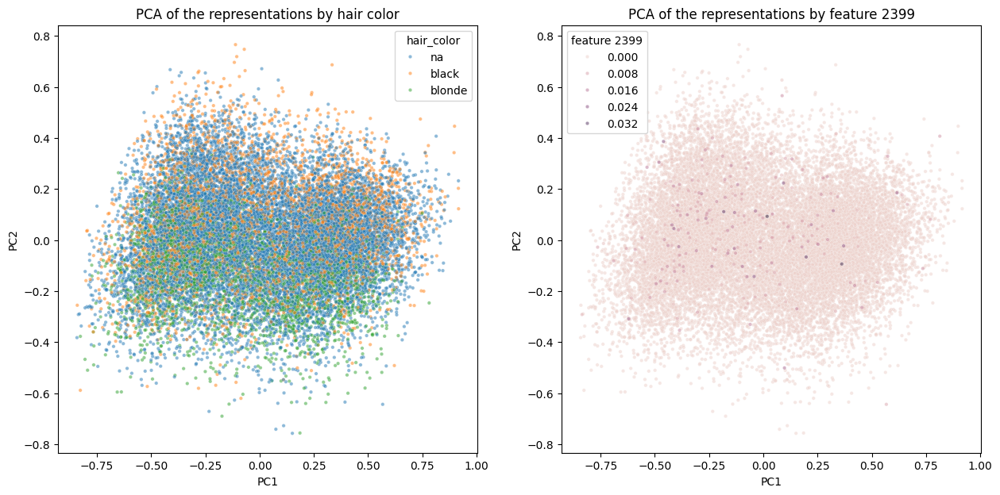

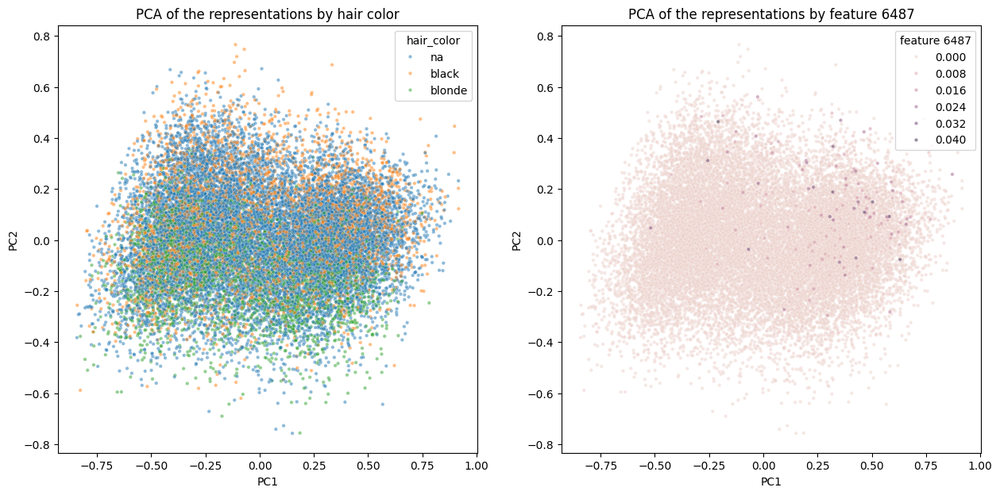

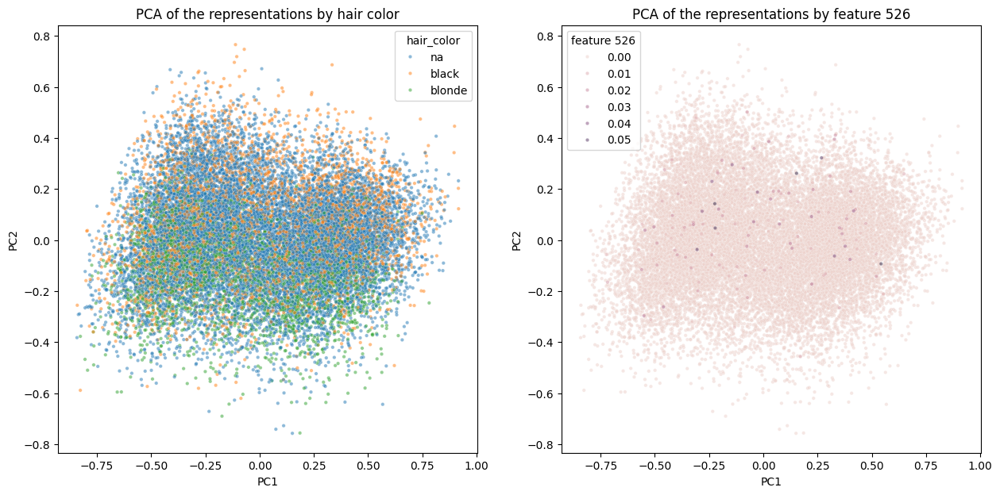

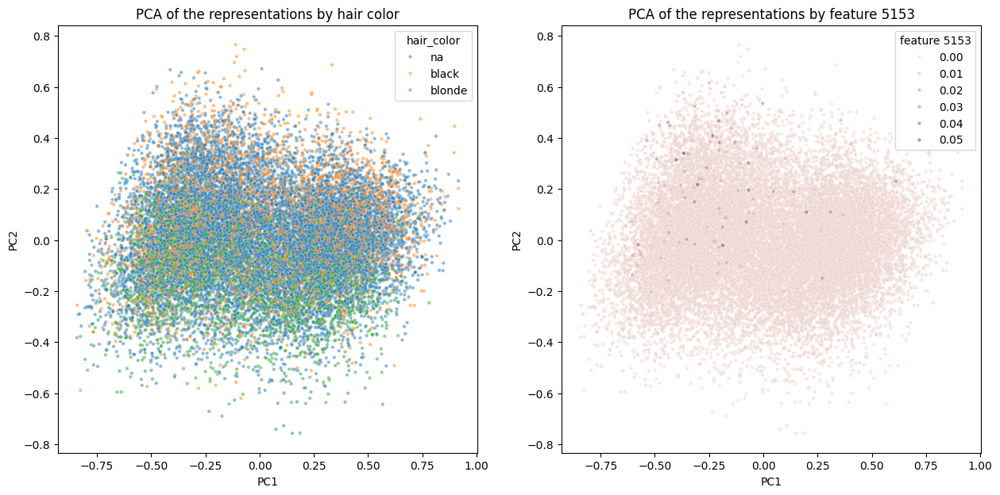

In [99]:
for feat in df_haircolor.head(10)['sae_feature'].values:
    df_pca[f'feature {feat}'] = activations[:, feat].detach().cpu().numpy()

    fig, ax = plt.subplots(1, 2, figsize=(15,7))
    sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='hair_color', ax=ax[0], s=10, alpha=0.5)
    ax[0].set_title('PCA of the representations by hair color')
    sns.scatterplot(data=df_pca.sort_values(f'feature {feat}'), x='PC1', y='PC2', hue=f'feature {feat}', ax=ax[1], s=10, alpha=0.5)
    ax[1].set_title(f'PCA of the representations by feature {feat}')
    plt.show()

      sae_feature  p_value_black_hair  fold_change_black_hair  \
1166         1559        9.132141e-14                0.120847   
3516         4677        2.941747e-10                0.145691   
5117         6746        2.464148e-13                0.158425   
1565         2109        9.291803e-25                0.182020   
6327         8324        4.112883e-11                0.195735   
833          1098        8.781990e-08                0.239700   
2580         3437        1.210621e-08                0.249725   
1876         2514        2.283844e-08                0.256460   
6924         9123        2.915074e-09                0.263289   
1875         2513        7.467716e-06                0.265554   

      p_value_blonde_hair  fold_change_blonde_hair  rank_black_hair  \
1166         1.165059e-04                 3.022435           3761.0   
3516         1.913254e-04                 2.655402           3760.0   
5117         9.097202e-06                 2.963433           3759.0   


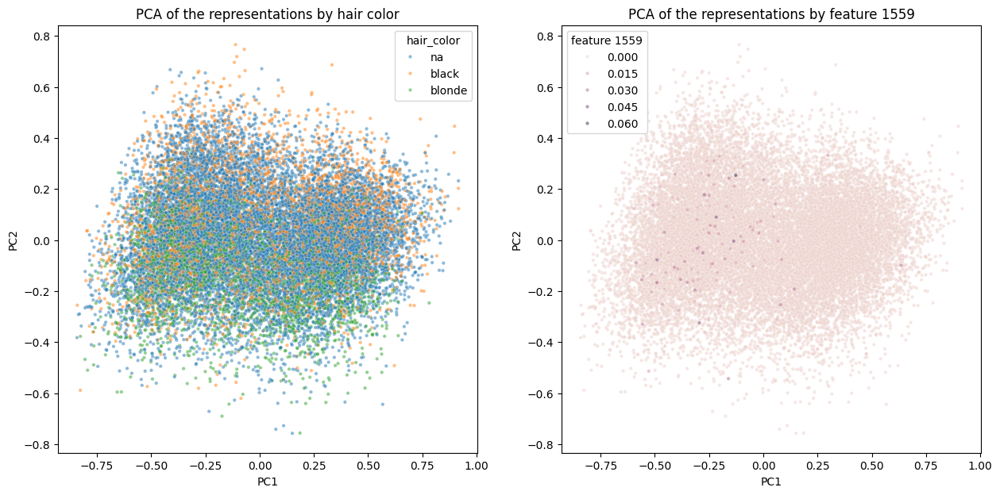

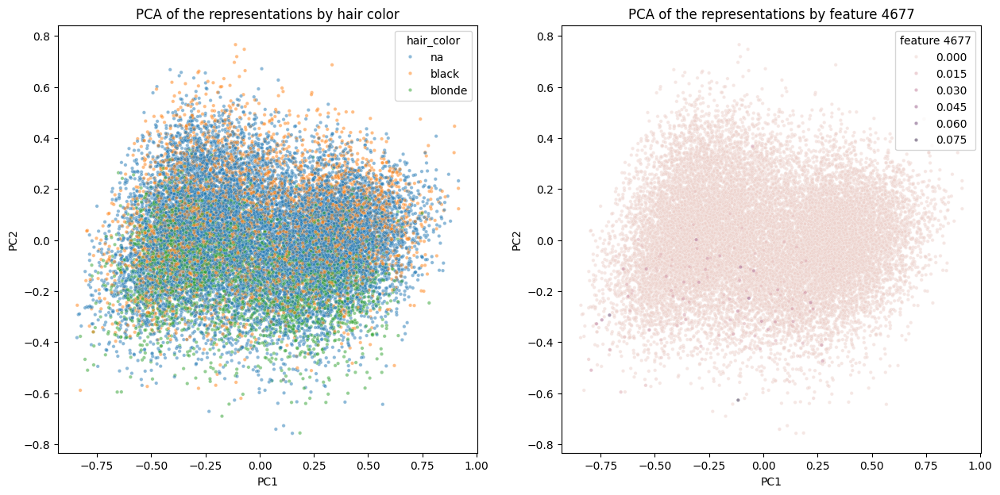

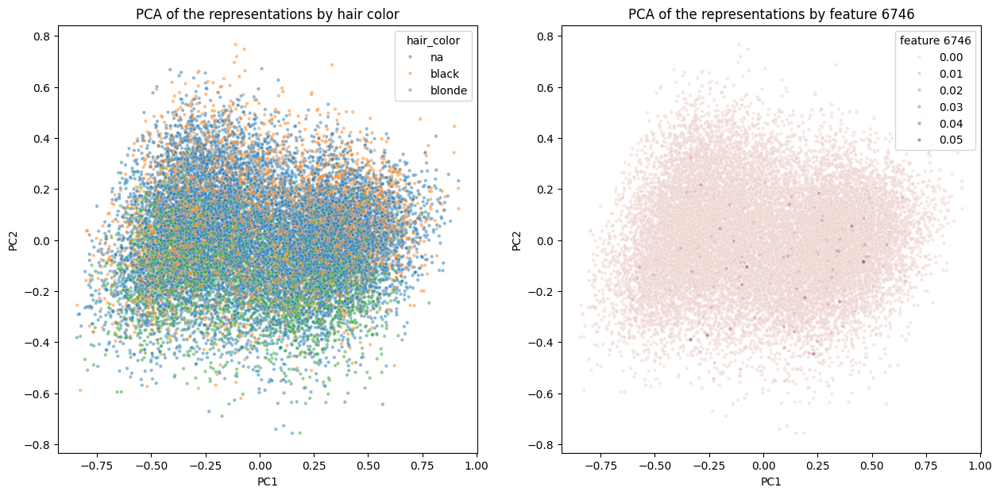

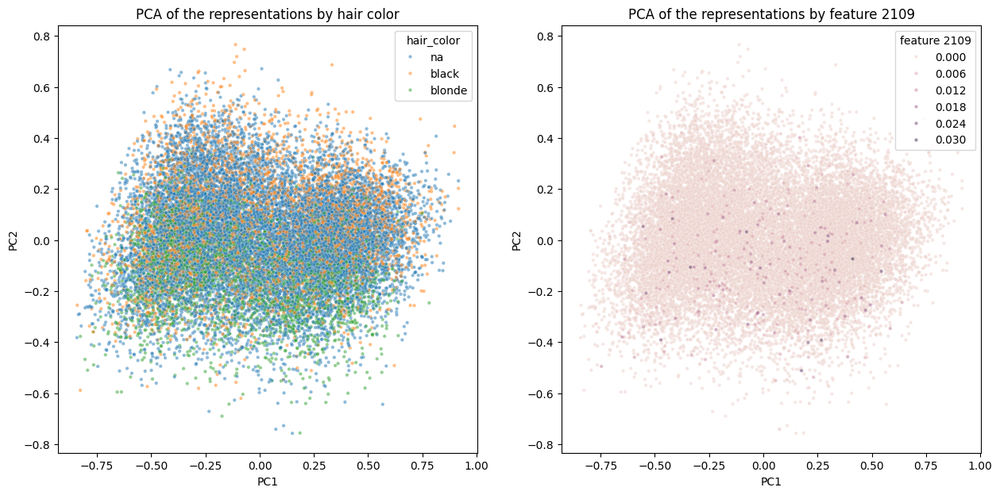

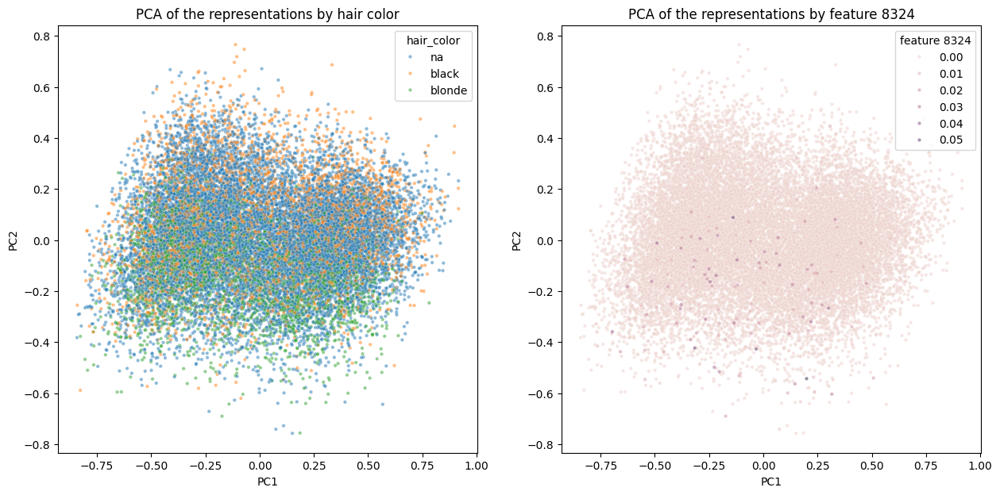

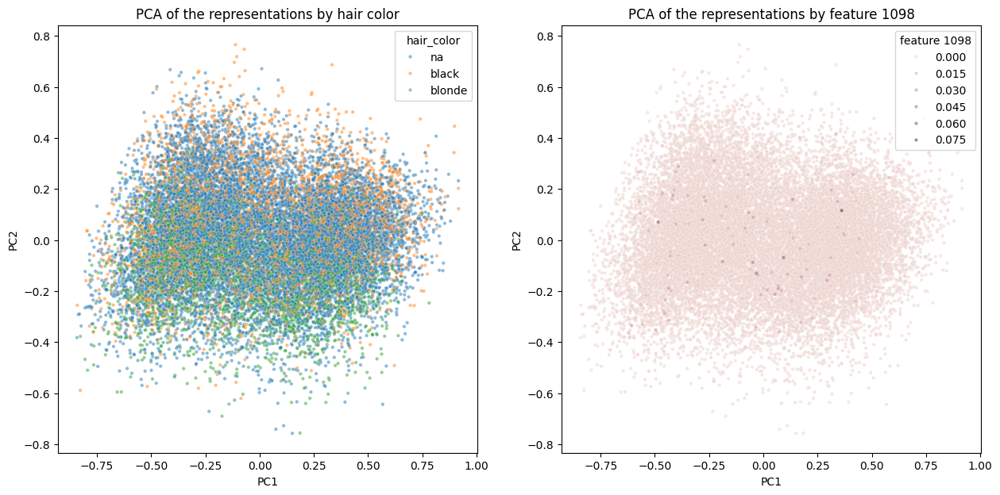

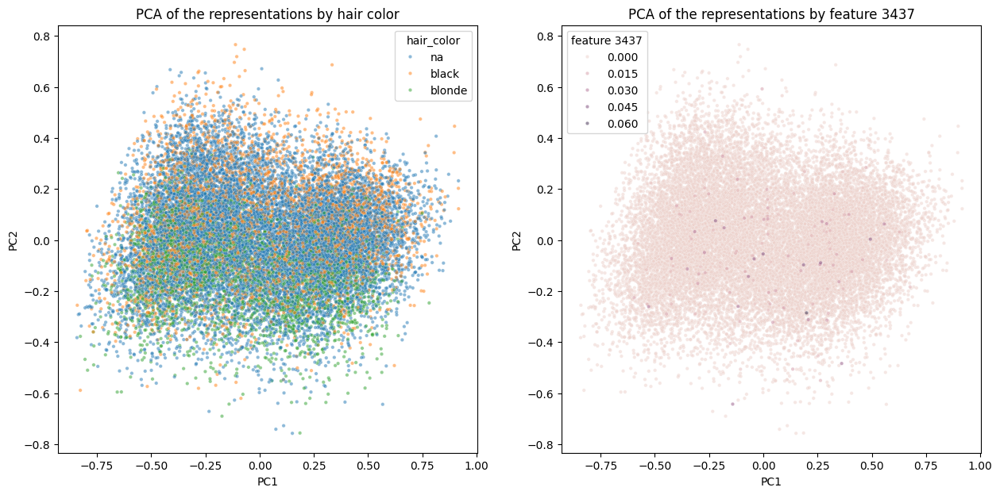

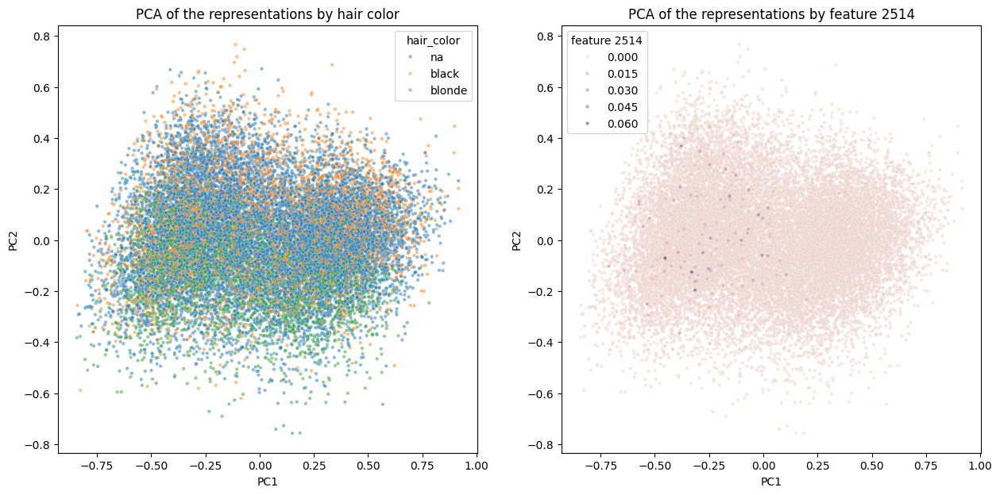

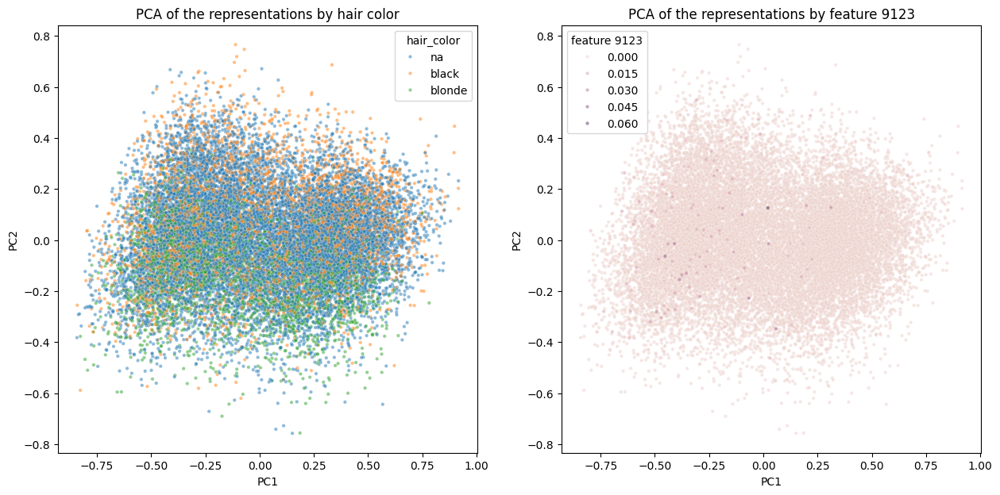

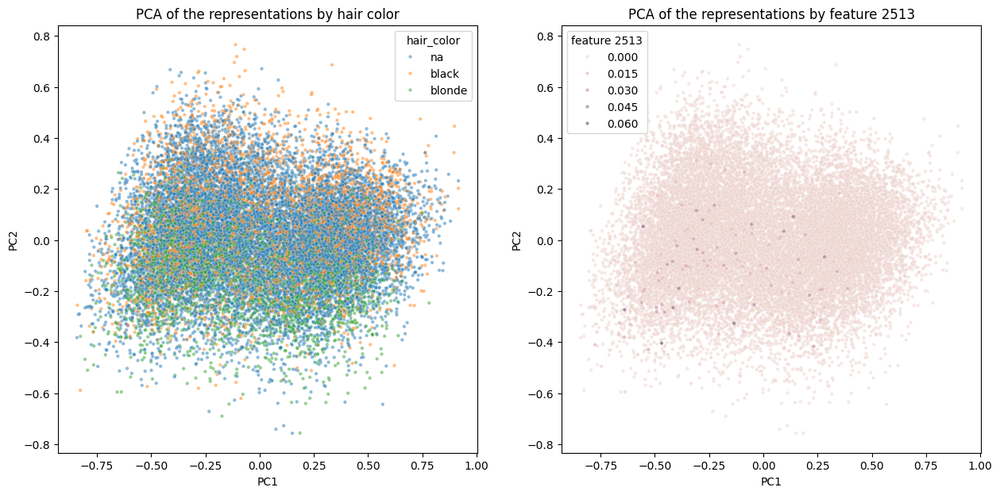

In [100]:
df_haircolor = df_haircolor.sort_values('fold_change_black_hair')
print(df_haircolor.head(10))

for feat in df_haircolor.head(10)['sae_feature'].values:
    df_pca[f'feature {feat}'] = activations[:, feat].detach().cpu().numpy()

    fig, ax = plt.subplots(1, 2, figsize=(15,7))
    sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='hair_color', ax=ax[0], s=10, alpha=0.5)
    ax[0].set_title('PCA of the representations by hair color')
    sns.scatterplot(data=df_pca.sort_values(f'feature {feat}'), x='PC1', y='PC2', hue=f'feature {feat}', ax=ax[1], s=10, alpha=0.5)
    ax[1].set_title(f'PCA of the representations by feature {feat}')
    plt.show()

      sae_feature  p_value_black_hair  fold_change_black_hair  \
5953         7858        2.382697e-46                0.656416   
4021         5323        2.795636e-49                0.577549   
4063         5373        1.085889e-91                0.488083   
5106         6731        1.256872e-91                0.529869   
1797         2407        4.851773e-87                0.456274   
2850         3787        4.288897e-35                0.579759   
73             92        2.602037e-56                0.496611   
1862         2493        1.692549e-29                0.579007   
4154         5485        4.191111e-16                0.659999   
3568         4747        3.726720e-25                0.574431   

      p_value_blonde_hair  fold_change_blonde_hair  rank_black_hair  \
5953        2.329206e-153                 2.296773           3445.0   
4021         8.929671e-98                 2.422678           3581.0   
4063         1.130648e-96                 2.293237           3663.0   


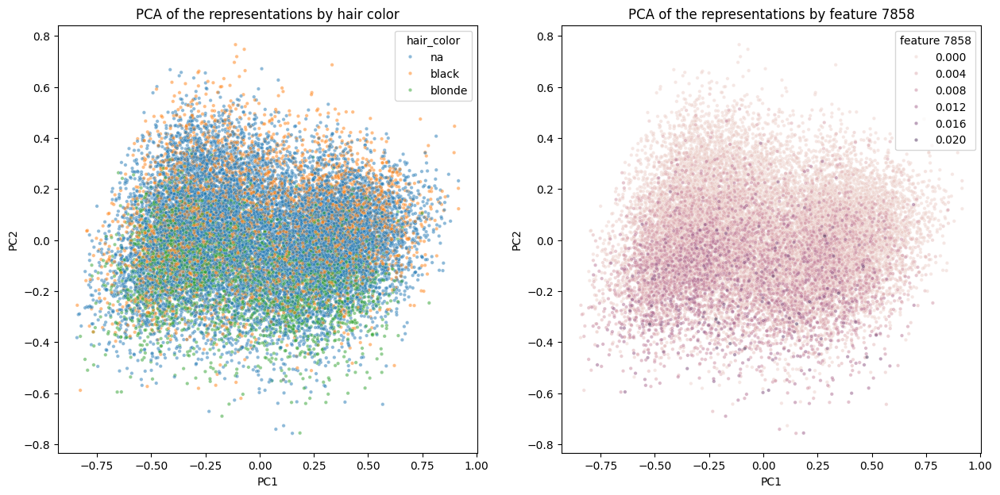

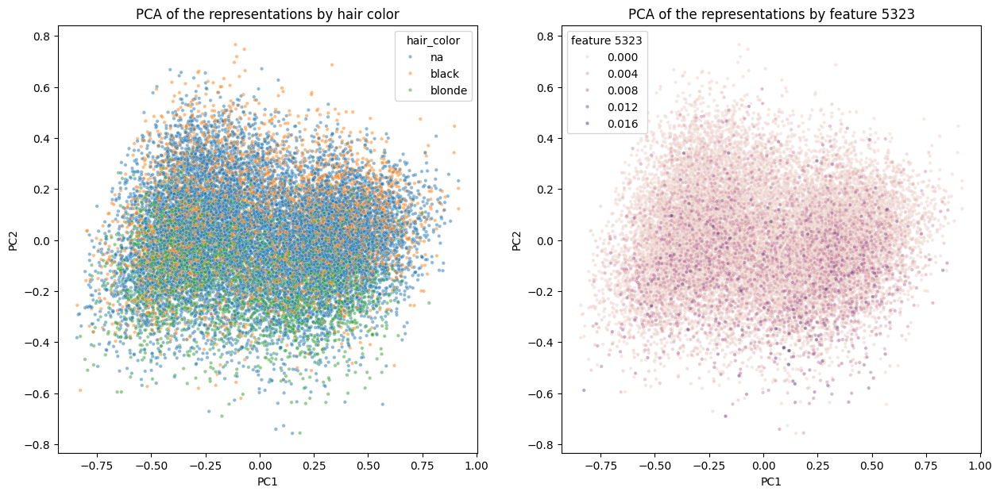

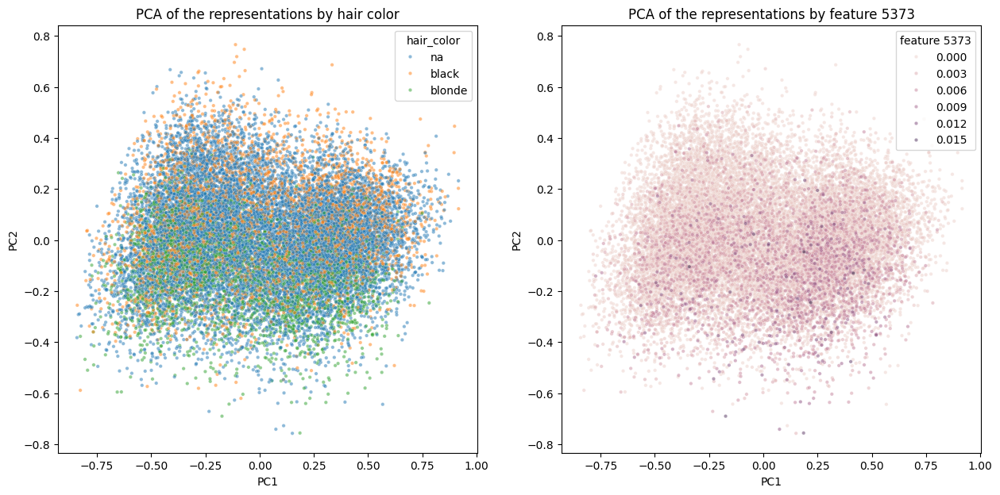

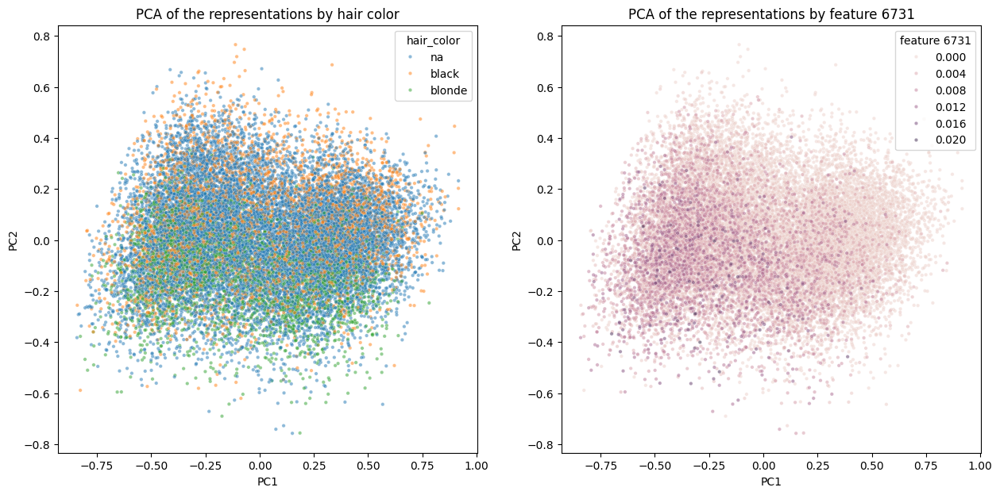

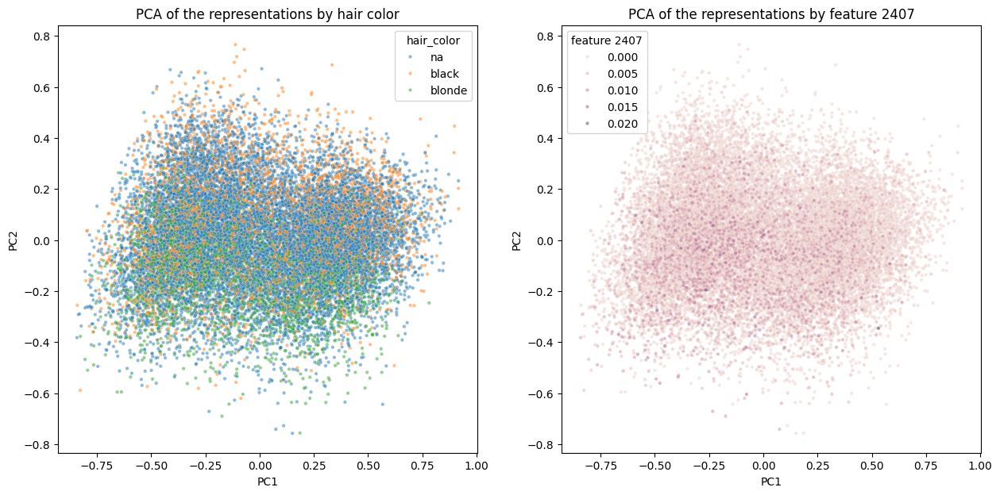

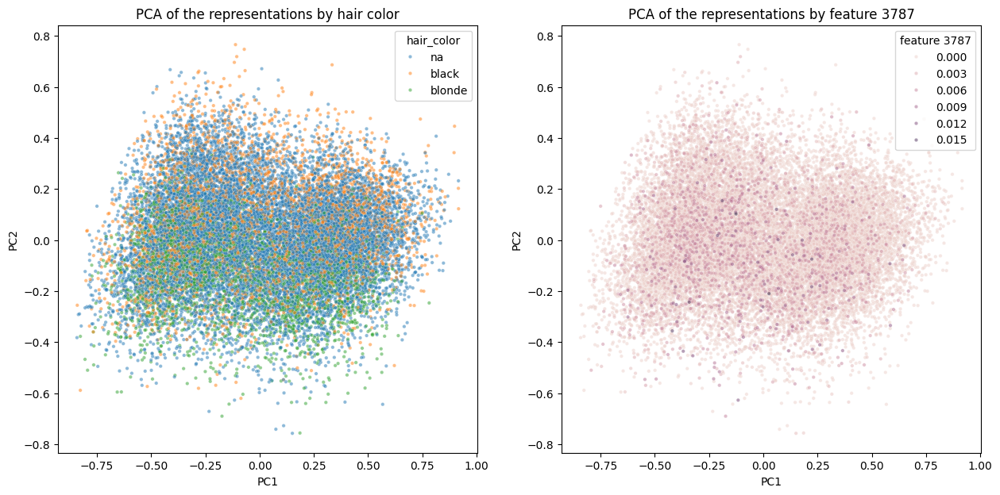

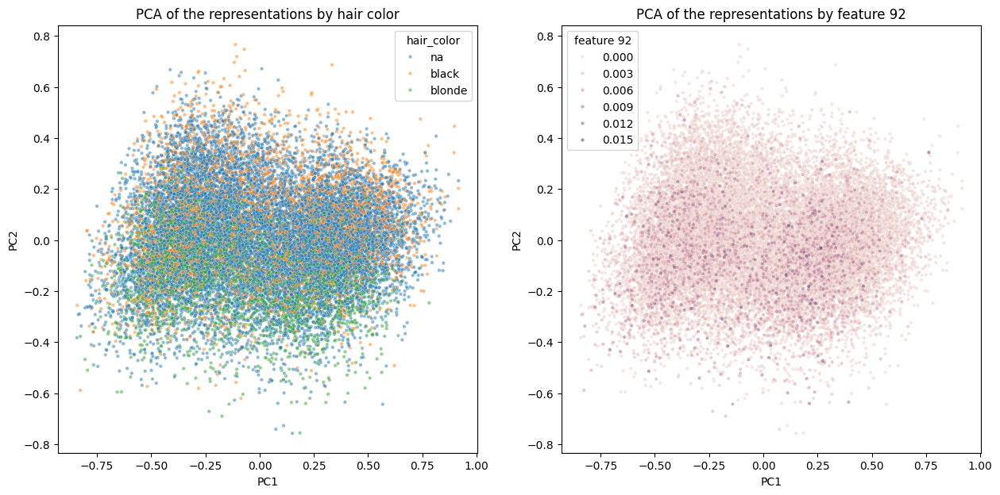

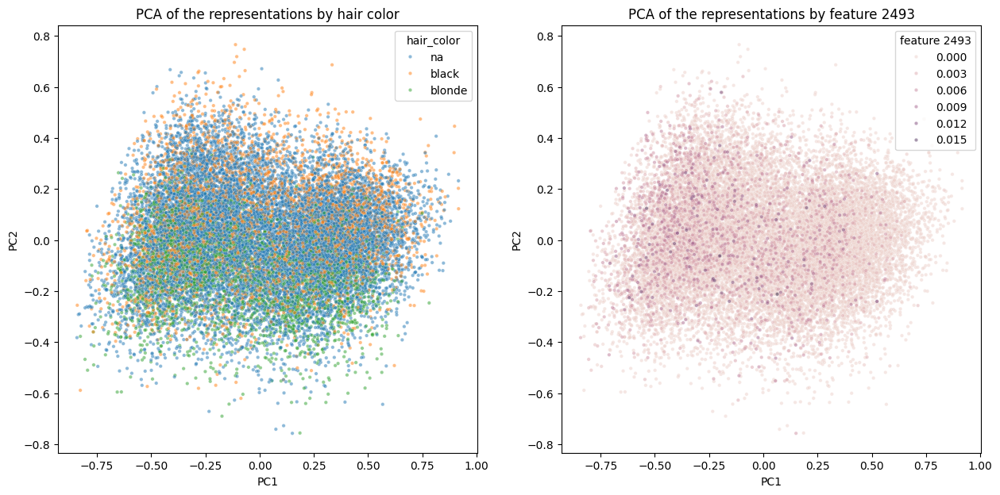

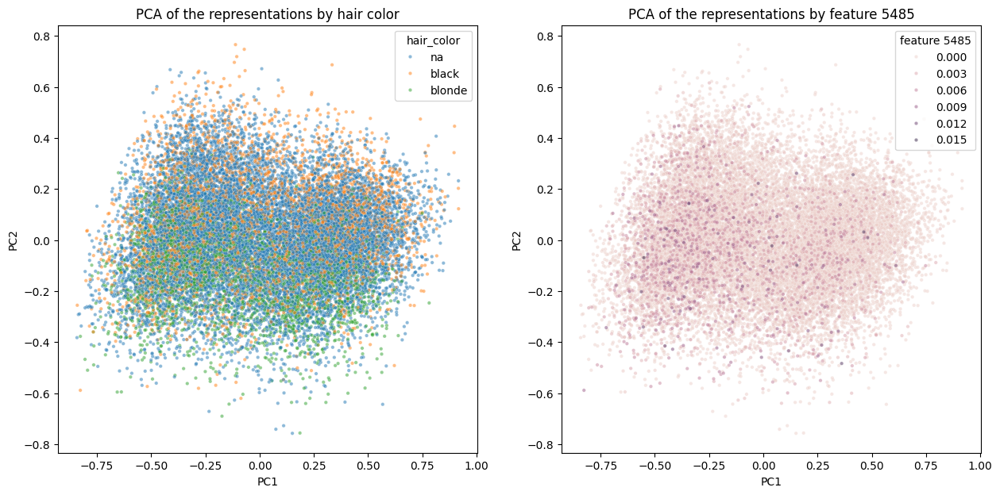

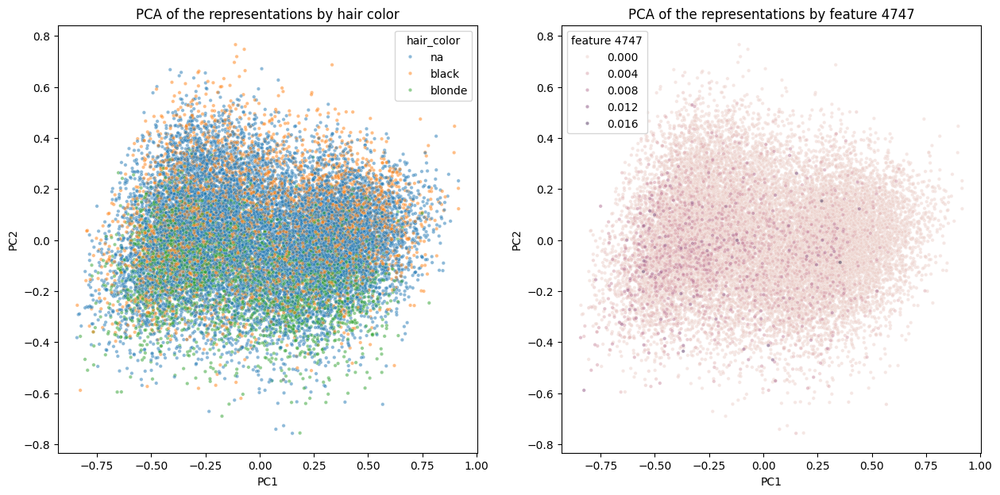

In [104]:
p_val_trheshold = 1e-3
fold_change_thresholds = [0.5, 2]
df_haircolor_blonde = df_haircolor.copy()
df_haircolor_blonde = df_haircolor_blonde[(df_haircolor_blonde['p_value_black_hair'] < p_val_trheshold) & (df_haircolor_blonde['p_value_blonde_hair'] < p_val_trheshold)]
df_haircolor_blonde = df_haircolor_blonde[df_haircolor_blonde['fold_change_blonde_hair'] > fold_change_thresholds[1]]
# sort by fold change
df_haircolor_blonde = df_haircolor_blonde.sort_values('p_value_blonde_hair')

print(df_haircolor_blonde.head(10))

for feat in df_haircolor_blonde.head(10)['sae_feature'].values:
    df_pca[f'feature {feat}'] = activations[:, feat].detach().cpu().numpy()

    fig, ax = plt.subplots(1, 2, figsize=(15,7))
    sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='hair_color', ax=ax[0], s=10, alpha=0.5)
    ax[0].set_title('PCA of the representations by hair color')
    sns.scatterplot(data=df_pca.sort_values(f'feature {feat}'), x='PC1', y='PC2', hue=f'feature {feat}', ax=ax[1], s=10, alpha=0.5)
    ax[1].set_title(f'PCA of the representations by feature {feat}')
    plt.show()

In [112]:
feat = 7858

# plot images of samples where the feature is the lowest and highest (10 low, 10 middle, 10 high)

# get the indices of the lowest and highest activations
lowest_indices = activations[:, feat].argsort()[:10]
middle_indices = activations[:, feat].argsort()[len(activations) // 2 - 5:len(activations) // 2 + 5]
highest_indices = activations[:, feat].argsort()[-10:]

In [108]:
print(os.getcwd())
#os.chdir("../..")
os.chdir("../decoder_first")
print(os.getcwd())

/home/dbm829/projects/interpreting_omics_models
/home/dbm829/projects/decoder_first


In [114]:
from torchvision import transforms

def plot_images(dataset, indices, title):
    fig, axs = plt.subplots(1, len(indices), figsize=(15, 3))
    for i, idx in enumerate(indices):
        img_tensor = dataset[idx][0]
        img = transforms.ToPILImage()(img_tensor)
        axs[i].imshow(img)
        axs[i].axis('off')
    fig.suptitle(title)
    plt.show()

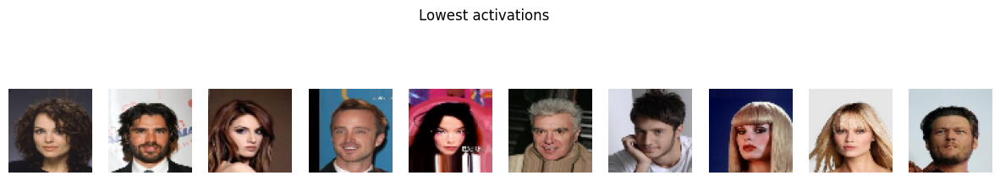

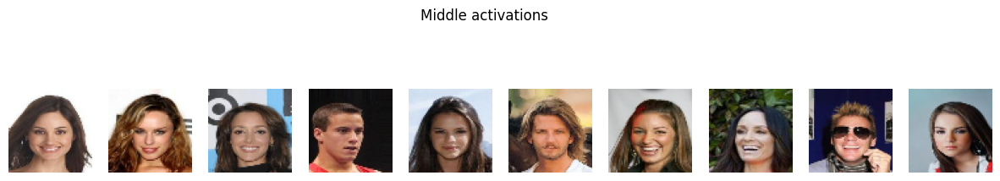

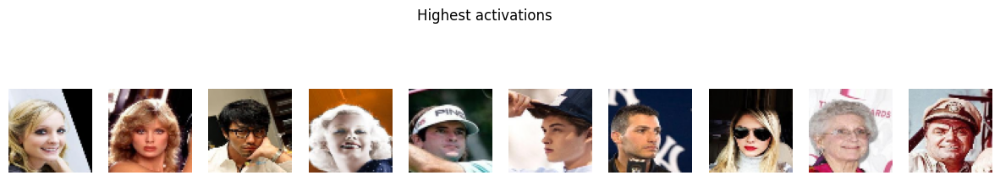

In [115]:
plot_images(model.val_set.data, lowest_indices, 'Lowest activations')
plot_images(model.val_set.data, middle_indices, 'Middle activations')
plot_images(model.val_set.data, highest_indices, 'Highest activations')

In [109]:
model.val_set.data[0][0]

/home/dbm829/.conda/envs/image_dgd_env/lib/python3.11/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


(tensor([[[0.1682, 0.1699, 0.1936,  ..., 0.2061, 0.2078, 0.2078],
          [0.1682, 0.1699, 0.1936,  ..., 0.2061, 0.2078, 0.2078],
          [0.1697, 0.1675, 0.1902,  ..., 0.2061, 0.2078, 0.2078],
          ...,
          [0.1020, 0.1020, 0.1020,  ..., 0.1020, 0.1020, 0.1020],
          [0.1020, 0.1020, 0.1020,  ..., 0.1020, 0.1020, 0.0965],
          [0.1020, 0.1020, 0.1020,  ..., 0.0957, 0.0988, 0.0941]],
 
         [[0.1604, 0.1621, 0.1857,  ..., 0.1982, 0.2000, 0.2000],
          [0.1604, 0.1621, 0.1857,  ..., 0.1982, 0.2000, 0.2000],
          [0.1619, 0.1597, 0.1823,  ..., 0.1982, 0.2000, 0.2000],
          ...,
          [0.0980, 0.0980, 0.0980,  ..., 0.0941, 0.0928, 0.0980],
          [0.0980, 0.0980, 0.0980,  ..., 0.0941, 0.0928, 0.0926],
          [0.0980, 0.0980, 0.0980,  ..., 0.0879, 0.0897, 0.0902]],
 
         [[0.2035, 0.2052, 0.2289,  ..., 0.2414, 0.2431, 0.2431],
          [0.2035, 0.2052, 0.2289,  ..., 0.2414, 0.2431, 0.2431],
          [0.2050, 0.2028, 0.2255,  ...,